In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, KFold
from sklearn.svm import SVR
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.decomposition import PCA
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import *

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

# First Engines Dataset

### Introduction

This notebook presents the database analysis from the first set of engines (FD001).

Both train and test datasets will be examined and, afterwards, predictive modelling will provide with the best achieved metrics for the RUL forecast.

The methodology considered is below explained:
- First, the different variables will be analysed and determined their weight in the dataset
- Along the study of the features' performances, it will be considered the removal due to consistency of future models
- Last, once the final datasets are modified and optimised, several predictive models and feature engineering will be applied. Each metric achieved will be consequently noted and best suitable model will be finally presented

Data Set: FD001

* Train trjectories: 100
* Test trajectories: 100
* Conditions: ONE (Sea Level)
* Fault Modes: ONE (HPC Degradation)

In [3]:
%store -r df_train_1
%store -r df_test_1
%store -r df_RUL_1

In [3]:
df_train_1.head()

,ID,Cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,sensor_measurement_6,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_10,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21,sensor_measurement_22,sensor_measurement_23,RUL
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN,187


In [4]:
df_test_1.head()

,ID,Cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,sensor_measurement_6,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_10,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21,sensor_measurement_22,sensor_measurement_23
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,NaN,NaN
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,NaN,NaN
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,NaN,NaN
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,NaN,NaN
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,NaN,NaN


In [5]:
df_RUL_1.head()

,RUL
0,112
1,98
2,69
3,82
4,91


### NaN values search

First step is to consider and check possible empty values in the dataset, which depending on the number and importance, will be contemplated to be removed or modified

In [6]:
for df,i in zip([df_train_1, df_test_1], ["train dataset","test dataset"]):
    print(i ,"\n"*2,
          df.isnull().sum(), "\n"*3)

train dataset 

 ID                           0
Cycle                        0
operational_setting_1        0
operational_setting_2        0
operational_setting_3        0
sensor_measurement_1         0
sensor_measurement_2         0
sensor_measurement_3         0
sensor_measurement_4         0
sensor_measurement_5         0
sensor_measurement_6         0
sensor_measurement_7         0
sensor_measurement_8         0
sensor_measurement_9         0
sensor_measurement_10        0
sensor_measurement_11        0
sensor_measurement_12        0
sensor_measurement_13        0
sensor_measurement_14        0
sensor_measurement_15        0
sensor_measurement_16        0
sensor_measurement_17        0
sensor_measurement_18        0
sensor_measurement_19        0
sensor_measurement_20        0
sensor_measurement_21        0
sensor_measurement_22    20631
sensor_measurement_23    20631
RUL                          0
dtype: int64 



test dataset 

 ID                           0
Cycle               

In [7]:
for df,i in zip([df_train_1, df_test_1], ["train dataset","test dataset"]):
    print("\n", i, "\n")
    for col in df.columns:
        
        print("percentage of NaN values in dataset for {}: ".format(col), 
              df[col].isnull().sum()*100/df.shape[0],"%")


 train dataset 

percentage of NaN values in dataset for ID:  0.0 %
percentage of NaN values in dataset for Cycle:  0.0 %
percentage of NaN values in dataset for operational_setting_1:  0.0 %
percentage of NaN values in dataset for operational_setting_2:  0.0 %
percentage of NaN values in dataset for operational_setting_3:  0.0 %
percentage of NaN values in dataset for sensor_measurement_1:  0.0 %
percentage of NaN values in dataset for sensor_measurement_2:  0.0 %
percentage of NaN values in dataset for sensor_measurement_3:  0.0 %
percentage of NaN values in dataset for sensor_measurement_4:  0.0 %
percentage of NaN values in dataset for sensor_measurement_5:  0.0 %
percentage of NaN values in dataset for sensor_measurement_6:  0.0 %
percentage of NaN values in dataset for sensor_measurement_7:  0.0 %
percentage of NaN values in dataset for sensor_measurement_8:  0.0 %
percentage of NaN values in dataset for sensor_measurement_9:  0.0 %
percentage of NaN values in dataset for sensor

Both sensors 22 and 23 have all their values as NaN, in both datasets. They will be removed

In [4]:
df_train_1 = df_train_1.dropna(axis=1)
df_test_1 = df_test_1.dropna(axis=1)

### Feature Analysis

The different features (columns) will be checked along an entire operational life, taking a random engine of the dataset

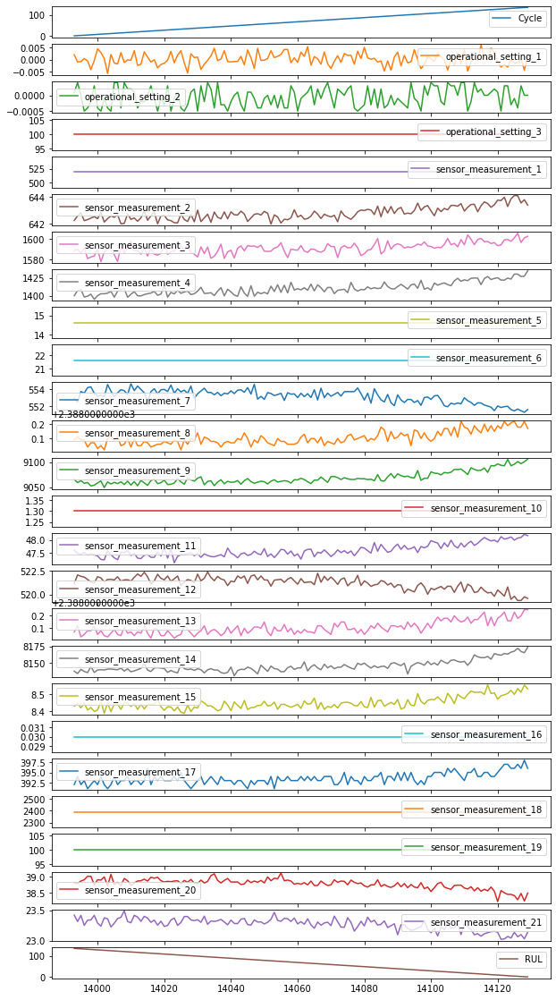

In [9]:
df_train_1[df_train_1.ID == 70].drop(columns=["ID"]).plot(subplots =True, figsize = (10,20));

Come considerations at this point:
- Directly confirmed the linear increase of the "Cycle" feature, along with the linear decrease of "RUL", both direclty opposite
- Sime features seem to have variation (some tend to increase while others seem to decrease throughout the engine life. Nevertheless, it is checked that some features seem to be constant during the entire life. This is something that will be deeper studied afterwards, and confirmed if is a matter of the engine ID or it is a common behaviour

Previously in the *Dataset Structure* notebook it has been introduced the "Max Cycle Life" parameter. Let's recover this feature to have an idea of the maximum life achieved by this dataset

Top 10 engines by maximum life achieved:

In [10]:
df_train_1[["ID","Cycle"]].groupby("ID").max(["Cycle"]).sort_values(by='Cycle', ascending=False).head(10)

,Cycle
ID,
69,362
92,341
96,336
67,313
83,293
2,287
95,283
64,283
86,278


Average maximum life reached in this engine's dataset:

Average value for max cycles reached by engines:  206.31


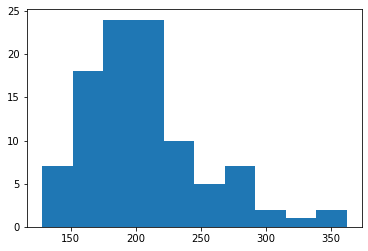

In [11]:
max_cycle_dataset_1 = df_train_1.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_dataset_1 = max_cycle_dataset_1.rename(columns={"Cycle":"Max_cycle"})
plt.hist(max_cycle_dataset_1["Max_cycle"])
print("Average value for max cycles reached by engines: ", max_cycle_dataset_1["Max_cycle"].mean())

Briefly checking the test dataset:

In [12]:
df_test_1[["ID","Cycle"]].groupby("ID").max(["Cycle"]).sort_values(by='Cycle', ascending=False).head(10)

,Cycle
ID,
49,303
93,244
91,234
62,232
12,217
81,213
76,205
34,203
100,198


Average value for max cycles reached by engines:  130.96


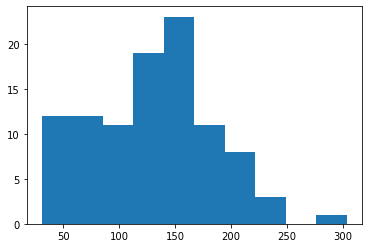

In [13]:
max_cycle_dataset_1 = df_test_1.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_dataset_1 = max_cycle_dataset_1.rename(columns={"Cycle":"Max_cycle"})
plt.hist(max_cycle_dataset_1["Max_cycle"])
print("Average value for max cycles reached by engines: ", max_cycle_dataset_1["Max_cycle"].mean())

It is confirmed that test dataset contains engines with lower number of cycles performed by each, as explained in *Datasets Structure* module

With below graph it is possible to visualize the linear distribution of each engine's RUL against the number of cycles achieved:

Text(0, 0.5, 'Max Cycle')

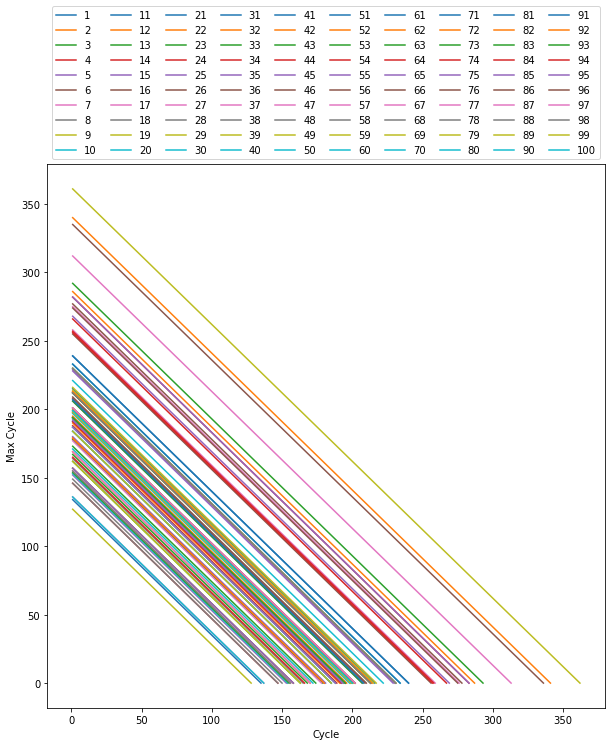

In [14]:
df_RUL_engine_1 = df_train_1[["ID","Cycle","RUL"]]
df_RUL_engine_1 = df_RUL_engine_1.pivot(index='Cycle', columns='ID', values='RUL')

df_RUL_engine_1.plot(figsize=(10, 10))
plt.legend(bbox_to_anchor=(0,1,1,1), loc=3,
       ncol=10, mode="expand")
plt.ylabel("Max Cycle")

Although there exist important differences in terms of maximum life achieved by each engine, the not-highly-distant distribution shows that there is only a single condition (SEA LEVEL) which affects the same way to each engine

### Operational Settings Study

As different parameter from the rest of sensor_measuremnts, these features deserved a single analysis to visualize their variation throughout the engine's performances

Max value for operational_setting_1: 0.0087 
 Min value for operational_setting_1: -0.0087 
 Average value for operational_setting_1: -8.870146866366216e-06 

Max value for operational_setting_2: 0.0006 
 Min value for operational_setting_2: -0.0006 
 Average value for operational_setting_2: 2.350831273326574e-06 

Max value for operational_setting_3: 100.0 
 Min value for operational_setting_3: 100.0 
 Average value for operational_setting_3: 100.0 



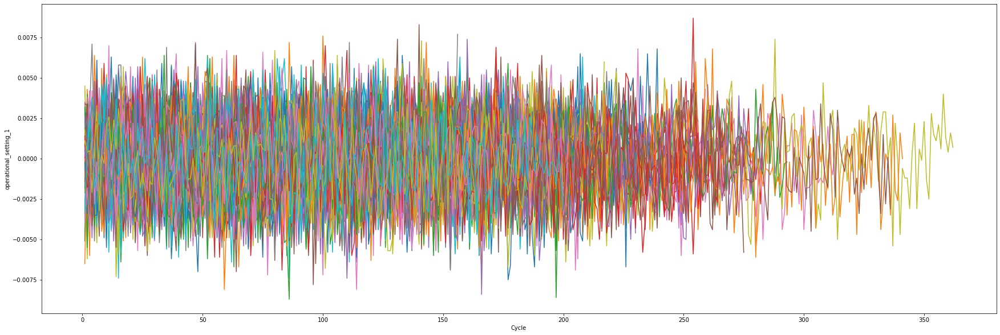

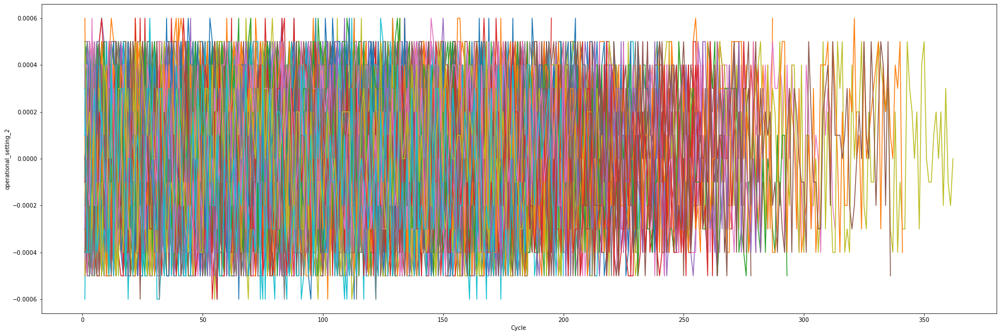

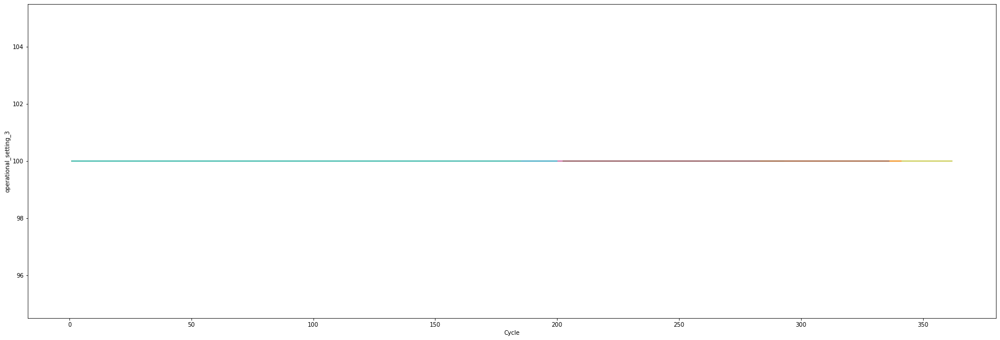

In [15]:
op_columns = ["operational_setting_1","operational_setting_2","operational_setting_3"]

for col in op_columns:
    print("Max value for {}:".format(col),df_train_1[col].max(), "\n",
         "Min value for {}:".format(col),df_train_1[col].min(), "\n",
        "Average value for {}:".format(col),df_train_1[col].mean(), "\n")
    
    df = df_train_1[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

Some observations regarding these plots
- First 2 operational settings vary in a different manner for each engine, which means each engine is mechanically and different in terms of performance
- These 2 operational settings are normal distributions, which deviation is practically zero, this is explained due to the noneffect of the internal engine performance to these parameters. Operational settings refer to external flight conditions and, hence, engine health status does not affect them
- Last, operational setting 3 is constant for every engine, during each flight. This might be explained because it is being analyzed an engine dataset that is under one only condition (SEA LEVEL)

Operational setting 3 will be then removed as it will not provide any useful information

Birefly comparing with test datset:

Max value for operational_setting_1: 0.0078 
 Min value for operational_setting_1: -0.0082 
 Average value for operational_setting_1: -1.117898594990834e-05 

Max value for operational_setting_2: 0.0007 
 Min value for operational_setting_2: -0.0006 
 Average value for operational_setting_2: 4.237935247403789e-06 

Max value for operational_setting_3: 100.0 
 Min value for operational_setting_3: 100.0 
 Average value for operational_setting_3: 100.0 



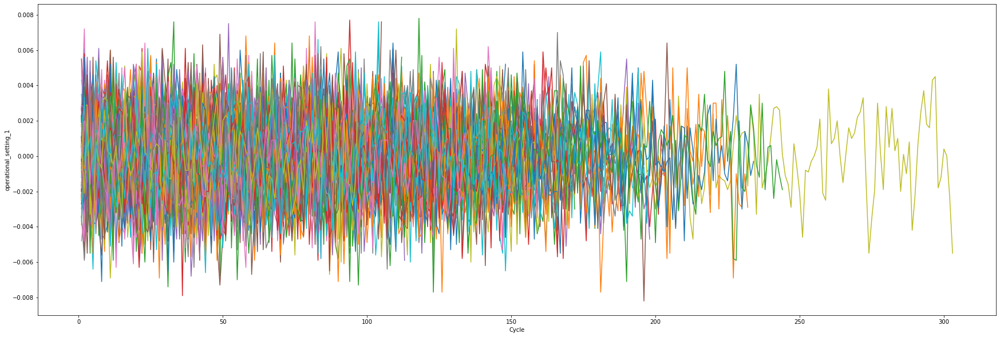

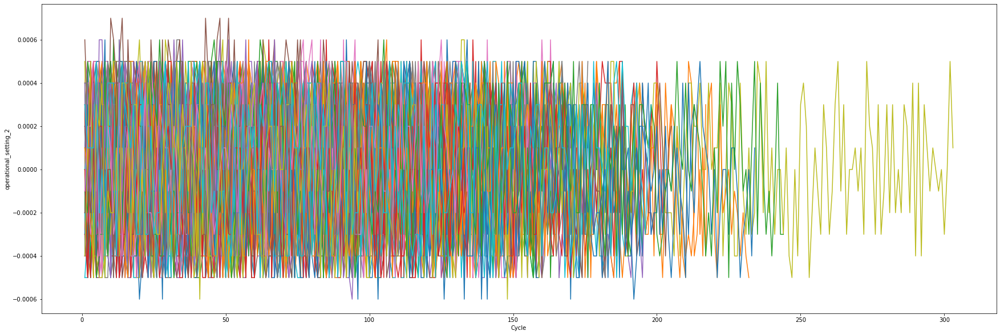

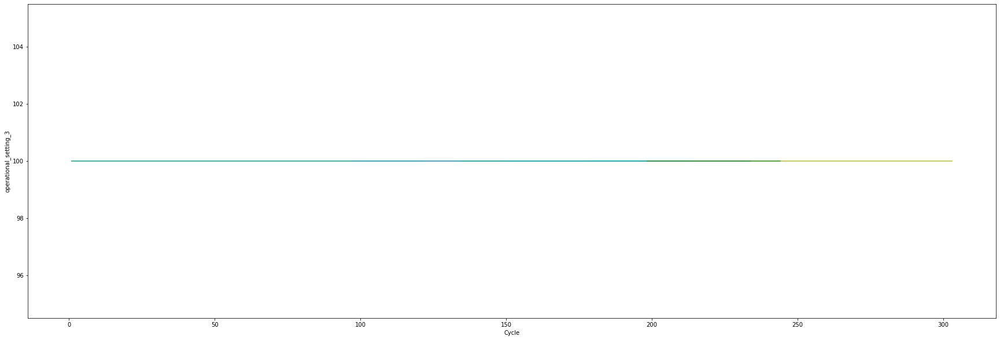

In [16]:
op_columns = ["operational_setting_1","operational_setting_2","operational_setting_3"]

for col in op_columns:
    print("Max value for {}:".format(col),df_test_1[col].max(), "\n",
         "Min value for {}:".format(col),df_test_1[col].min(), "\n",
        "Average value for {}:".format(col),df_test_1[col].mean(), "\n")
    
    df = df_test_1[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

In [5]:
df_train_1.drop(columns="operational_setting_3",axis=1, inplace=True)
df_test_1.drop(columns="operational_setting_3",axis=1, inplace=True)

C:\Users\lcastrov\Anaconda3_\lib\site-packages\pandas\core\frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


Let's quickly have a check of the remaining operational settings behaviour, separating by engine

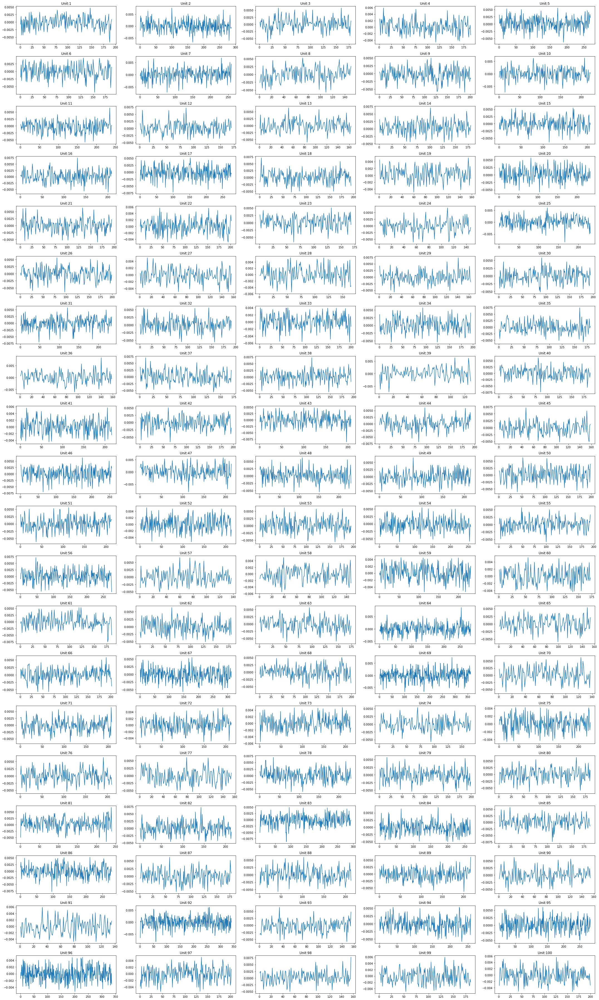

In [18]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_1[df_train_1.ID == i+1], x = "Cycle", y = "operational_setting_1", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

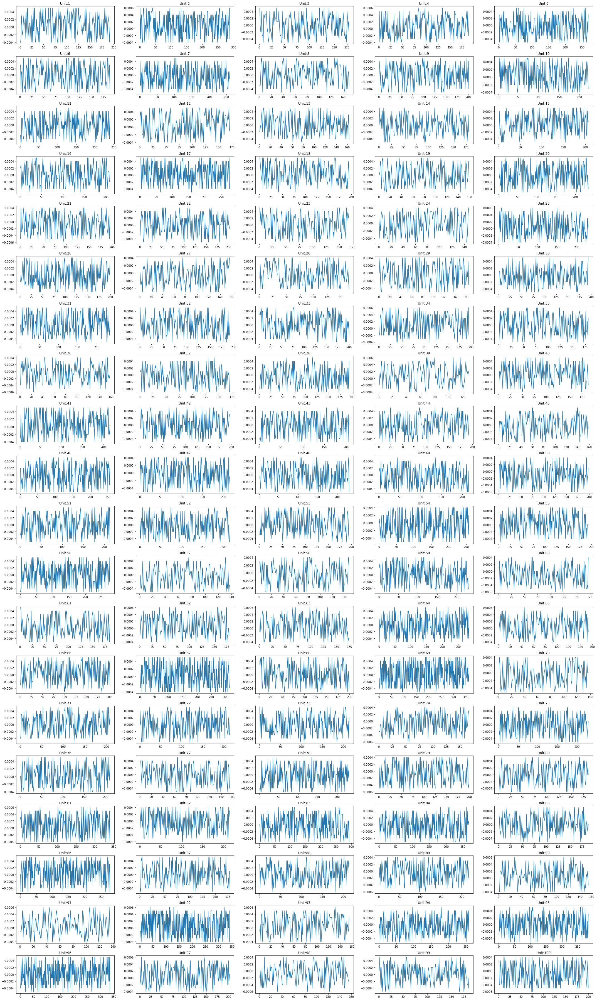

In [19]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_1[df_train_1.ID == i+1], x = "Cycle", y = "operational_setting_2", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

No engine presents constant behaviour for these settings, hence, no further modifications are expected with these features

### Sensor Measurements Analysis

Sensor's behaviour will be now plotted and reviewed, where the different characteristics will be exposed and finally considerations will be taken

Let's have a vision of each sensor's performance for a specific input engine

Write the unit engine number to get the sensor measurements: 12


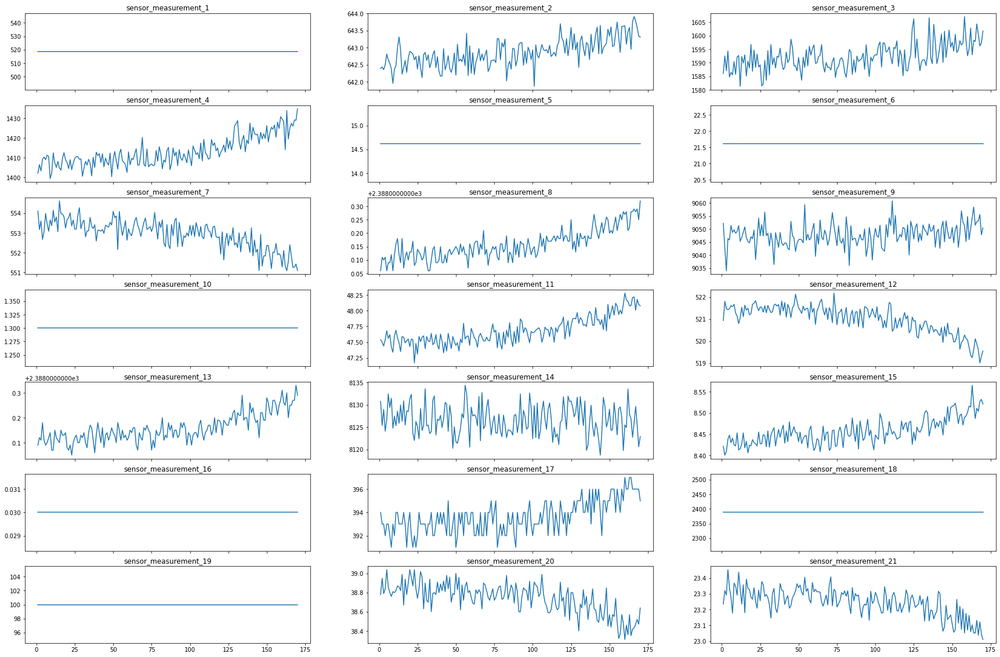

In [20]:
bfig,ax=plt.subplots(7,3,figsize=(30,20),sharex=True)

unit = input("Write the unit engine number to get the sensor measurements: ")
df_unit = df_train_1[df_train_1["ID"]==int(unit)]

contador = 0
for i in range(0,7):
    for j in range(0,3):
        ax[i,j].plot(df_unit["Cycle"], df_unit['sensor_measurement_'+str(contador+1)])
        ax[i,j].set_title('sensor_measurement_'+str(contador+1))
        contador+=1
        
plt.show()

At first sight it is already possible to identify sensors which do not change over the cycles of the engine input.

These will be automatically highlighted if the standard deviation is analysed

In [6]:
sensor_columns = df_train_1.columns[4:-1]
df_std_train = df_train_1.groupby(["ID"])[sensor_columns].std()
constant_sensors_train = []
for col in df_std_train:
    if df_std_train[col].mean()<1e-10:
        constant_sensors_train.append(col)
        
df_std_test = df_test_1.groupby(["ID"])[sensor_columns].std()
constant_sensors_test = []
for col in df_std_test:
    if df_std_test[col].mean()<1e-10:
        constant_sensors_test.append(col)

print("sensors constant through lifecycle in Train dataset: ","\n", constant_sensors_train, "\n"*2,
     "sensors constant through lifecycle in Test dataset: ", "\n",constant_sensors_test)

constant_sensors_train == constant_sensors_test

sensors constant through lifecycle in Train dataset:  
 ['sensor_measurement_1', 'sensor_measurement_5', 'sensor_measurement_10', 'sensor_measurement_16', 'sensor_measurement_18', 'sensor_measurement_19'] 

 sensors constant through lifecycle in Test dataset:  
 ['sensor_measurement_1', 'sensor_measurement_5', 'sensor_measurement_10', 'sensor_measurement_16', 'sensor_measurement_18', 'sensor_measurement_19']


True

In [22]:
for col in constant_sensors_train:    
    print(col, df_train_1[col].value_counts(), "\n",
         "proportion compared by entire dataset values of this sensor: ", 
          int(df_train_1[col].value_counts().values)*100/df_train_1.shape[0], "% \n")
        

sensor_measurement_1 518.67    20631
Name: sensor_measurement_1, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_5 14.62    20631
Name: sensor_measurement_5, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_10 1.3    20631
Name: sensor_measurement_10, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_16 0.03    20631
Name: sensor_measurement_16, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_18 2388    20631
Name: sensor_measurement_18, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_19 100.0    20631
Name: sensor_measurement_19, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 



Sensors contained in above list not only show a non-variation behaviour through the performance of every engine in the train and test datasets, but also seems that they have the same constant value in the entire dataset.

Hence, as no information will be obtained from them, these 6 sensors will be removed

Additionally, from the last plot, it has also been stant out the *sensor_measurement_6*, which has a behaviour quite atypical. Let's focus on it now

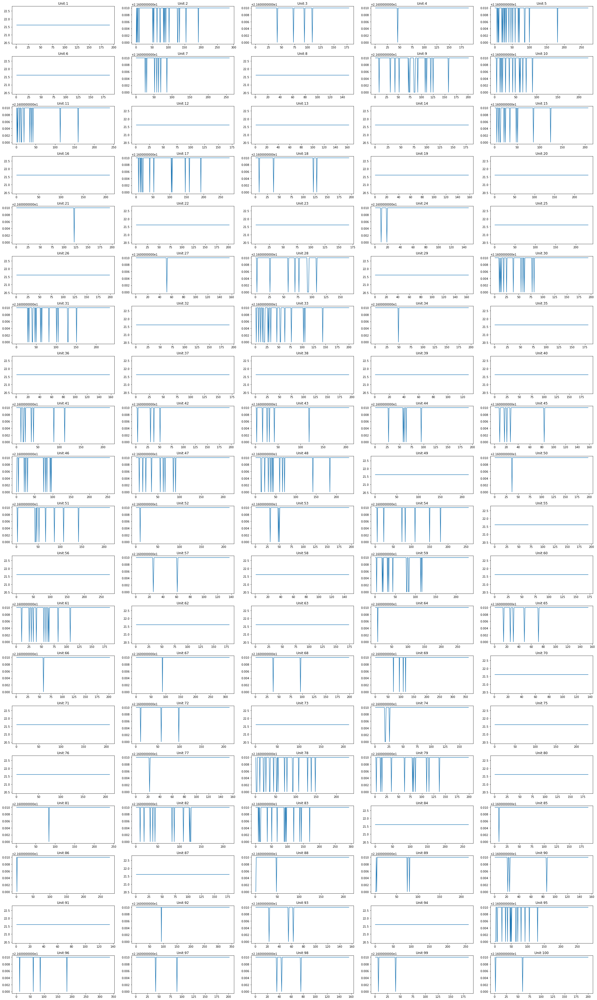

In [23]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))
ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_1[df_train_1.ID == i+1], x = "Cycle", y = "sensor_measurement_6", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

In [24]:
for df,i in zip([df_train_1, df_test_1], ["train dataset","test dataset"]):
    print("Mean standard deviation per engine for {}".format(i), df.groupby(["ID"])["sensor_measurement_6"].std().mean())
print("\n")
for df,i in zip([df_train_1, df_test_1], ["train dataset","test dataset"]):
    print("Value counts of sensor measurement 6 for {}".format(i),"\n", df["sensor_measurement_6"].value_counts(),"\n")
        

Mean standard deviation per engine for train dataset 0.0009590898202656538
Mean standard deviation per engine for test dataset 0.0012396237851479293


Value counts of sensor measurement 6 for train dataset 
 21.61    20225
21.60      406
Name: sensor_measurement_6, dtype: int64 

Value counts of sensor measurement 6 for test dataset 
 21.61    12704
21.60      392
Name: sensor_measurement_6, dtype: int64 



Checking the plots of this sensor per engine and with the calculation of the mean standard deviation, together with the only 2 values achieved by this sensor in both train and test datasets, It is understood that this sensor will neither provide useful information for future models, hence, it will be removed as well

In [7]:
df_train_1.drop(constant_sensors_train + ["sensor_measurement_6"], axis=1, inplace=True)
df_test_1.drop(constant_sensors_test + ["sensor_measurement_6"], axis=1, inplace=True)

In [26]:
df_test_1

,ID,Cycle,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21
0,1,1,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,643.24,1599.45,1415.79,553.41,2388.02,9142.37,47.69,520.69,2388.00,8213.28,8.4715,394,38.65,23.1974
13092,100,195,-0.0011,-0.0001,643.22,1595.69,1422.05,553.22,2388.05,9140.68,47.60,521.05,2388.09,8210.85,8.4512,395,38.57,23.2771
13093,100,196,-0.0006,-0.0003,643.44,1593.15,1406.82,553.04,2388.11,9146.81,47.57,521.18,2388.04,8217.24,8.4569,395,38.62,23.2051
13094,100,197,-0.0038,0.0001,643.26,1594.99,1419.36,553.37,2388.07,9148.85,47.61,521.33,2388.08,8220.48,8.4711,395,38.66,23.2699


Next step is to find possible correlations between the remaining features, and with the target.
To do so, a correlation matrix will be developed

In [8]:
corr_matrix = df_train_1.corr()
corr_matrix.style.background_gradient(cmap='coolwarm', vmin=-1, vmax=1,)

,ID,Cycle,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL
ID,1.000000,0.078753,-0.017895,-0.006197,0.014133,0.012621,0.026116,-0.032073,0.039929,-0.052053,0.024707,-0.031882,0.044230,-0.059473,0.022486,0.013513,-0.020589,-0.016465,0.078753
Cycle,0.078753,1.000000,-0.004527,0.016132,0.549898,0.543947,0.624577,-0.595914,0.475977,0.443999,0.634385,-0.611354,0.477523,0.370324,0.588676,0.566995,-0.583597,-0.585923,-0.736241
operational_setting_1,-0.017895,-0.004527,1.000000,0.011660,0.009030,-0.005651,0.009544,-0.009437,-0.000427,-0.004279,0.011658,-0.001491,0.002318,-0.004469,0.007652,0.002599,-0.005713,-0.014559,-0.003198
operational_setting_2,-0.006197,0.016132,0.011660,1.000000,0.007266,0.009068,0.014673,-0.016678,0.013285,-0.005425,0.011690,-0.010923,0.018156,-0.006310,0.014156,0.012280,-0.010554,-0.007846,-0.001948
sensor_measurement_2,0.014133,0.549898,0.009030,0.007266,1.000000,0.602610,0.714949,-0.702136,0.662325,0.273764,0.740020,-0.724578,0.661792,0.179752,0.675975,0.629886,-0.661841,-0.668050,-0.606484
sensor_measurement_3,0.012621,0.543947,-0.005651,0.009068,0.602610,1.000000,0.678413,-0.664595,0.602481,0.322964,0.695900,-0.680307,0.600963,0.237137,0.639921,0.600017,-0.625941,-0.633901,-0.584520
sensor_measurement_4,0.026116,0.624577,0.009544,0.014673,0.714949,0.678413,1.000000,-0.793130,0.746852,0.297429,0.830136,-0.815591,0.745158,0.190748,0.758459,0.703499,-0.748067,-0.745193,-0.678948
sensor_measurement_7,-0.032073,-0.595914,-0.009437,-0.016678,-0.702136,-0.664595,-0.793130,1.000000,-0.767132,-0.217835,-0.822805,0.812713,-0.764611,-0.110053,-0.747051,-0.692893,0.736163,0.737447,0.657223
sensor_measurement_8,0.039929,0.475977,-0.000427,0.013285,0.662325,0.602481,0.746852,-0.767132,1.000000,-0.032091,0.782213,-0.786540,0.826084,-0.144787,0.700949,0.627785,-0.687030,-0.688840,-0.563968
sensor_measurement_9,-0.052053,0.443999,-0.004279,-0.005425,0.273764,0.322964,0.297429,-0.217835,-0.032091,1.000000,0.274591,-0.210238,-0.034763,0.963157,0.293753,0.337110,-0.285280,-0.292795,-0.390102


This correlation matrix provides 2 different insights:
- There exists no strong correlation between different data features, with the exception of sensor 9 and sensor 14
- Appart from some specific case, all features have a similar correlation with the target variable (highest is, obviosly, achieved by the "Cycle". At this stage, no assumption can be taken to "upgrade" any feature above others

Let's directly catch the most correlated features:

In [28]:
corr_matrix_df = pd.DataFrame(corr_matrix.values, columns=corr_matrix.columns, index=corr_matrix.index)

high_correlated_features = []
for col in corr_matrix_df:
    correlated_cols = corr_matrix_df[col]
    pair_identified  = correlated_cols.apply(lambda x: abs(x)>0.9) # above this value it exists a High Correlation
    index_of_pair = correlated_cols[pair_identified].index
    
    for idx, corr in zip(index_of_pair, correlated_cols[pair_identified].values):
        high_correlated_features.append((col, idx, corr))
        
items_repeat = []
for i in high_correlated_features:
    if i[2] == 1:
        items_repeat.append(i)
        
detected_correlated_features = set(high_correlated_features).symmetric_difference(set(items_repeat))
detected_correlated_features 

{('sensor_measurement_14', 'sensor_measurement_9', 0.9631566003059776),
 ('sensor_measurement_9', 'sensor_measurement_14', 0.9631566003059776)}

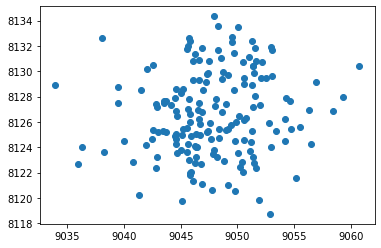

In [29]:
df_corr_sensors = df_unit
plt.scatter(df_corr_sensors['sensor_measurement_9'], df_corr_sensors['sensor_measurement_14'])
plt.show()

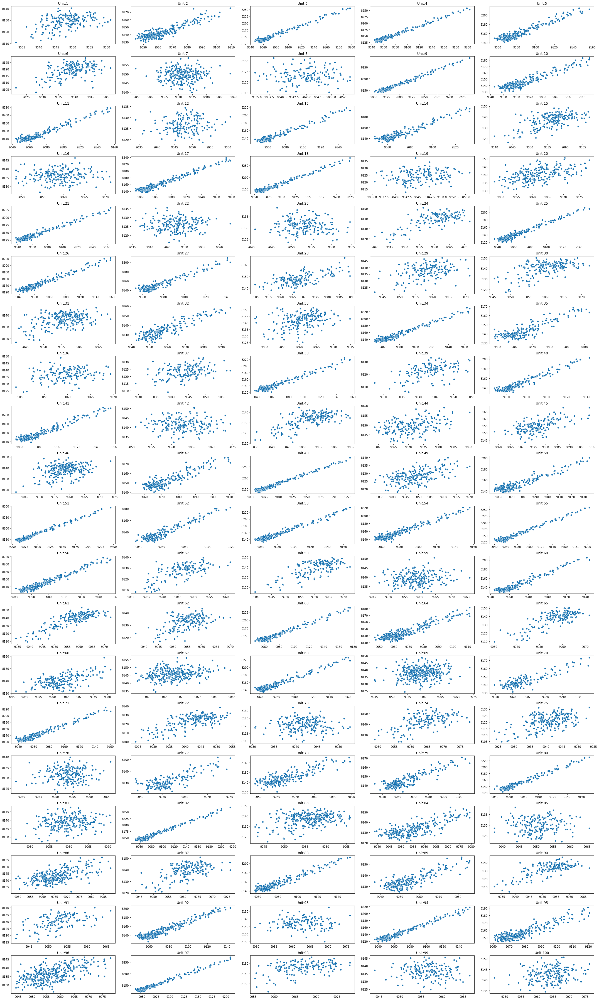

In [30]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.scatterplot(data = df_train_1[df_train_1.ID == i+1], x = "sensor_measurement_9", y = "sensor_measurement_14", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

The correlation between these 2 sensors has been confirmed by several methods, their behaviours correlate linearly positive in the majority of engines. At this stage it will be assumed that one of these sensors must be removed.

It is then chosen sensor 14 to be dropped, as it has the lower correlation with the target variable

In [9]:
df_train_1.drop("sensor_measurement_14", axis=1, inplace=True)
df_test_1.drop("sensor_measurement_14", axis=1, inplace=True)

Let's have a vision of the aspect of the resulting train dataset sensor's performances

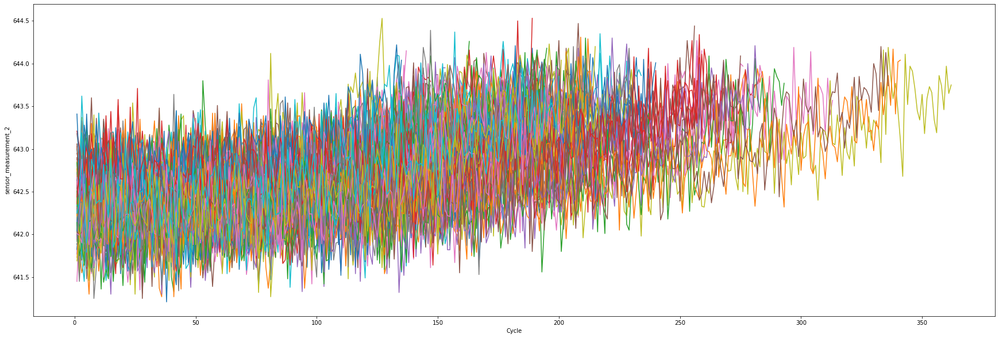

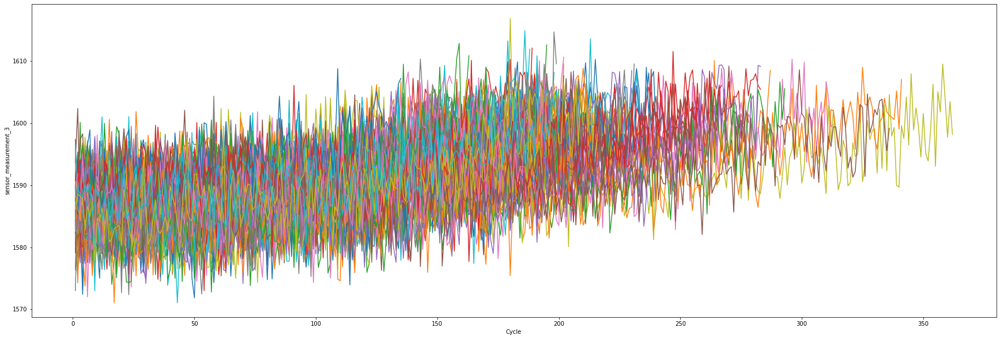

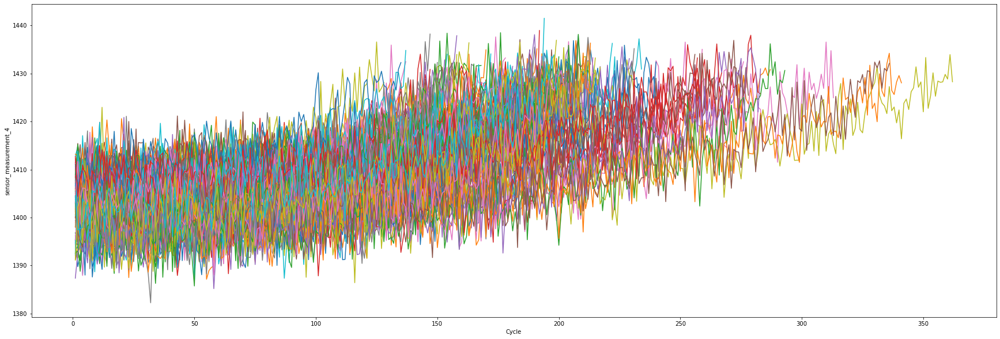

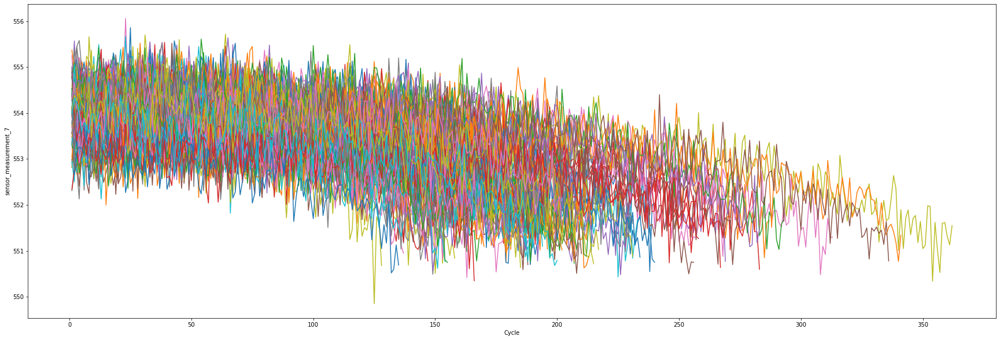

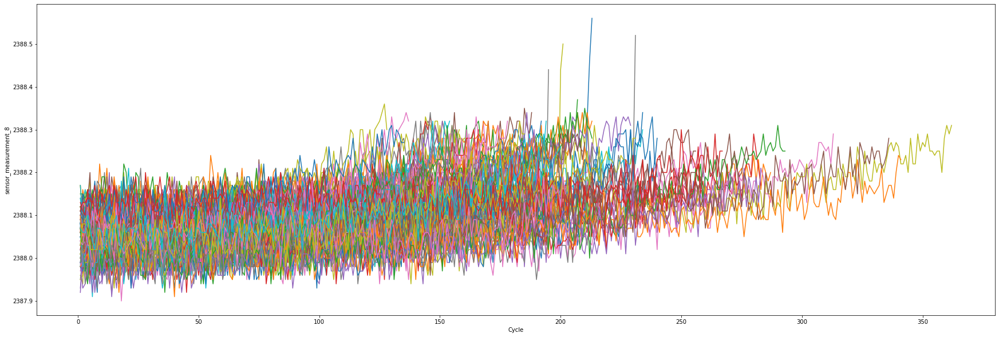

...

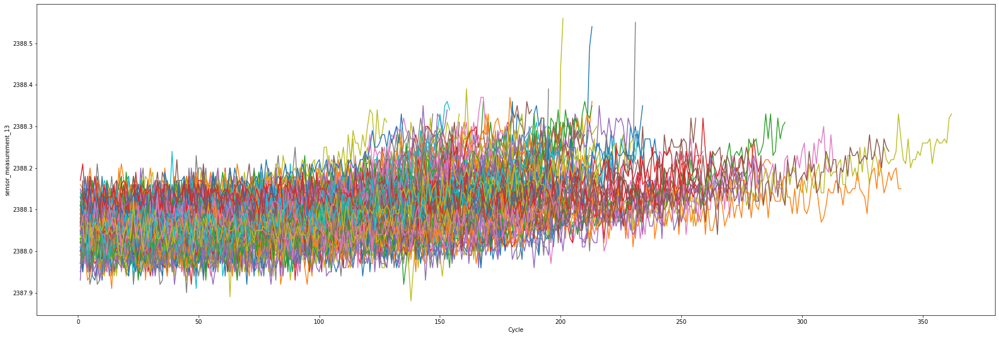

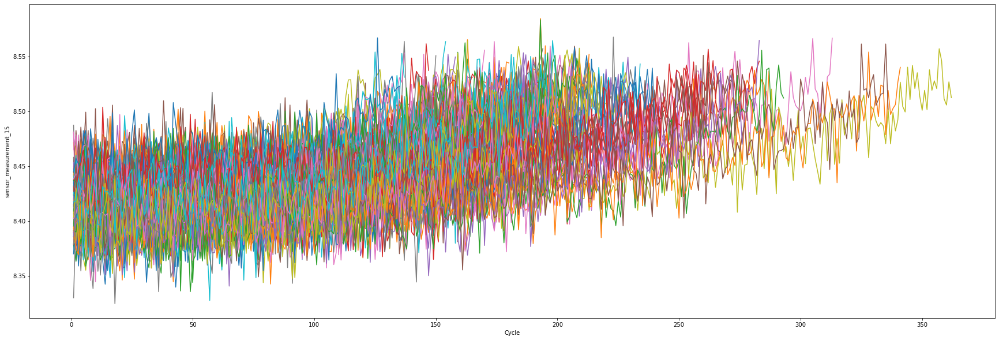

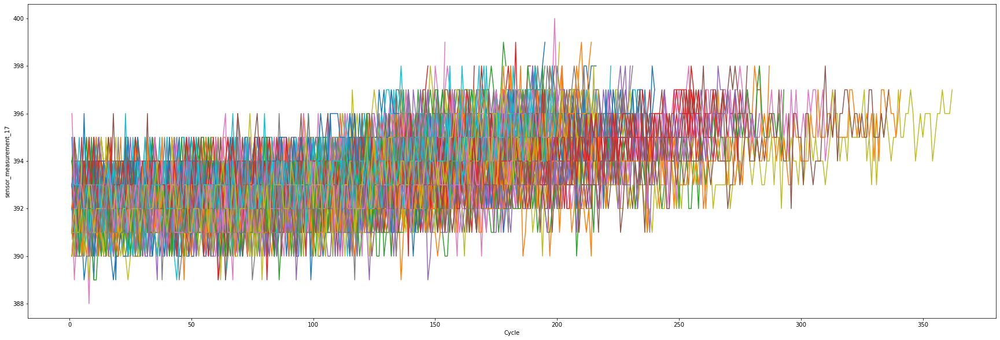

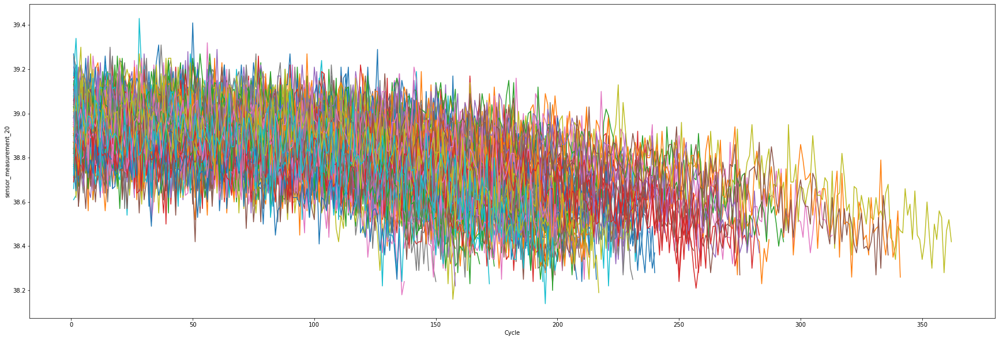

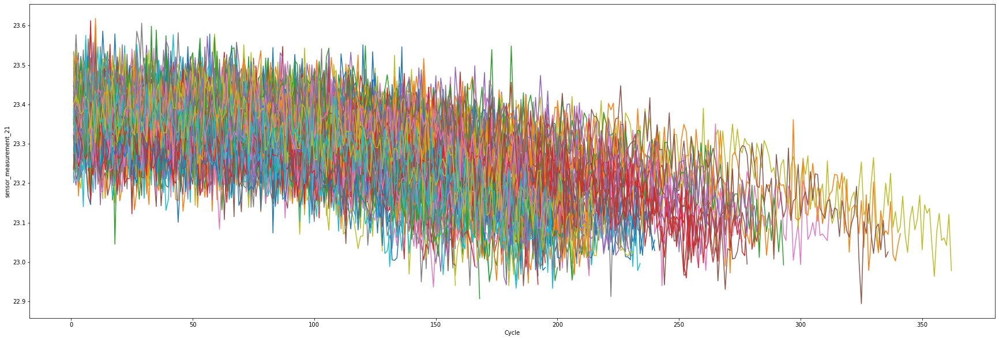

In [32]:
sensor_columns = df_train_1.columns[4:-1].tolist()
for col in sensor_columns:
    
    df = df_train_1[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

In [44]:
df_train_1.to_pickle("df_stream.pkl")
df_test_1.to_pickle("df_stream_test.pkl")
df_RUL_1.to_pickle("df_stream_rul.pkl")

# Predictive Models Introduction

First step before start predicting and developing ML models is to set the different train and test subsets, from their respective databases

Hence, **X_train** and **y_train** will come from the Train Dataset, **X_test** will be featured from the Test Dataset, and finally **y_test** will come directly from RUL Dataset

In [8]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1) # Target variable must be out of X_train
y_train = df_train_1["RUL"]

df_test_1_red = df_test_1.groupby("ID").last().reset_index() # y_test is a single value per engine (100 units)
                                                            # hence, X_test's lenght must be equally 100
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

In [10]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((20631, 15), (20631,), (100, 15), (100, 1))

## First Model: Linear Regression

In [47]:
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [48]:
preds_y_train = lr.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_train, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_train, preds_y_train))
lr_TR_score = r2_score(y_train, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  27.68539128919656 
 MSE:  1996.609336014649 
 RMSE:  44.68343469357127 
 R2 score:  0.5791615760470854


In [49]:
preds_y_test = lr.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_y_test))
lr_TS_score = r2_score(y_test, preds_y_test)

TEST SCORES - - - -  
 MAE:  20.350894668448746 
 MSE:  1042.8056960525923 
 RMSE:  32.29250216462937 
 R2 score:  0.3961294494659049


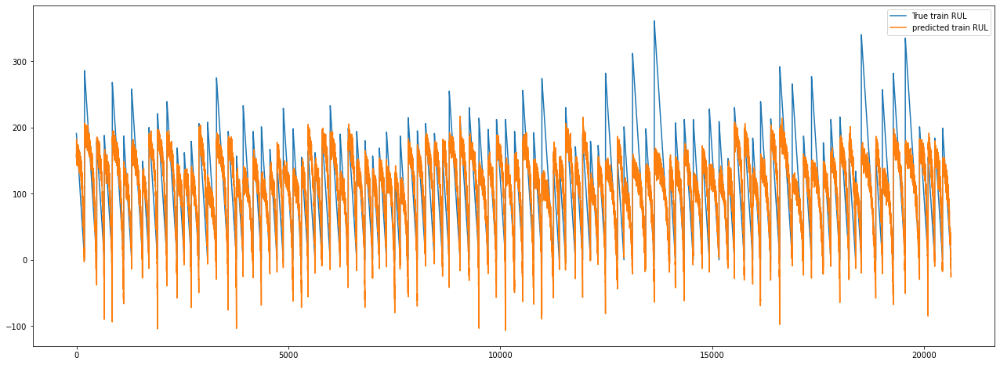

In [50]:
plt.figure(figsize = (22, 8))

plt.plot(y_train, label="True train RUL")
plt.plot(preds_y_train, label="predicted train RUL")
plt.legend()
plt.show()

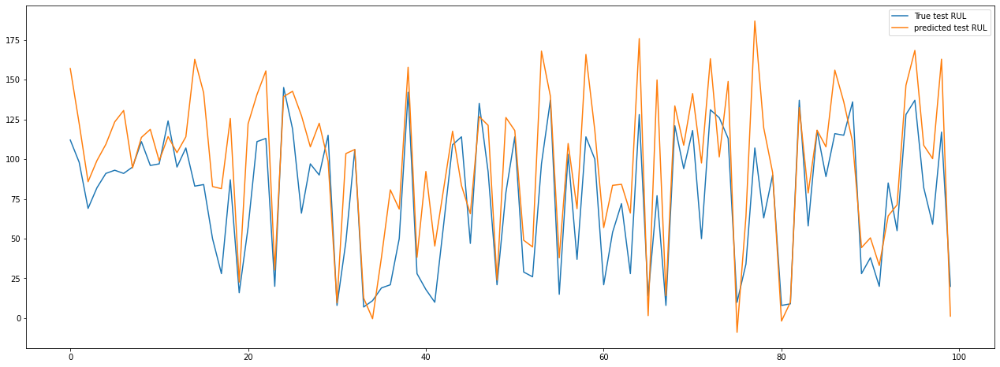

In [51]:
plt.figure(figsize = (22, 8))

plt.plot(y_test, label="True test RUL")
plt.plot(preds_y_test, label="predicted test RUL")
plt.legend()
plt.show()

A simple linear regression has been applied to this set, with the following metrics:
- Train r2 Score: 0.579
- Test r2 Score: 0.396

As expected, accuracy is not too high, but this is the very first model developed. Let's now try with a more complex model, the Support Vector Regressor

## Second Model: Random Forest Regressor

In [52]:
n_estimators = [int(x) for x in np.linspace(start = 10, stop = 100, num = 100)]

max_depth = [int(x) for x in np.linspace(10, 100, num = 10)]
min_samples_leaf = [int(x) for x in np.linspace(start = 1, stop = 10, num = 10)]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
              "min_samples_leaf":min_samples_leaf}
print(random_grid)

regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train, y_train)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_train, y_train)

{'n_estimators': [10, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100], 'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]}


RandomForestRegressor(max_depth=9, min_samples_leaf=10, n_estimators=64)

In [53]:
rul_train_pred_rf = hyper_regr.predict(X_train)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train, rul_train_pred_rf))
rf_TR_score = r2_score(y_train, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  18.604071701971094 
 MSE:  1511.5729686704285 
 RMSE:  38.878952772296074 
 R2 score:  0.6813958673083034


In [54]:
rul_test_pred_rf = hyper_regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))
rf_TS_score = r2_score(y_test, rul_test_pred_rf)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  18.918653897286916 
 MSE:  1065.193792884029 
 RMSE:  32.637306765173335 
 R2 score:  0.38316489393059594


This model has achieved an increase in train score, but lower accuracy with the test score

## Second Model: Support Vector Regressor

SVR insights are well explained in the thesis document.

In order to provide accurate results, the data must be pre-scaled before fitting in the SVR, to do so, it will be used the Standard Scaler

In [13]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
regr.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [14]:
svr_preds_train = regr.predict(X_train)
print("SVR TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_train, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_train, svr_preds_train))
svr_TR_score = r2_score(y_train, svr_preds_train)

SVR TRAIN SCORES - - - -  
 MAE:  20.207105282145022 
 MSE:  1827.7211803380164 
 RMSE:  42.75185587010249 
 R2 score:  0.6147592385327962


In [15]:
svr_preds_test = regr.predict(X_test)
print("SVR TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(y_test, svr_preds_test))
svr_TS_score = r2_score(y_test, svr_preds_test)

SVR TEST SCORES - - - -  
 MAE:  10.461170640728824 
 MSE:  695.2252110588136 
 RMSE:  26.36712367814915 
 R2 score:  0.5974072326834559


In this case it is observed an important increase in r2 score for both train and test sets. As RFR, SVR allows hyperparametrization. Hence, it will be searched the best combination of parameters for SVR


These above 3 different models (Linear Regressor, Random Forest Regressor and SVR) are the ones selected in this project to be tested along the diverse feature engineering from this point. The different metrics will be noted and compared after every featuring step

# Featuring Engineering Process 

## Top Features

At this point, it may be conceived tha, what is causing a not-too-high accuracy in the models is, maybe, the high number of features of the datasets. Features that may not impact the minimum necessary to the model forecast.
Hence, in this step, is contemplated the scenario of determine the top features of the dataset in terms of importance. To do so, it has been agreed to base the logic in the strength of the variation for each feature.

This means that, the higher a variable varies throughout the engine life, it means that more important will be this feature to determine the RUL prediction. This variation is directly proportional to the slope of each feature

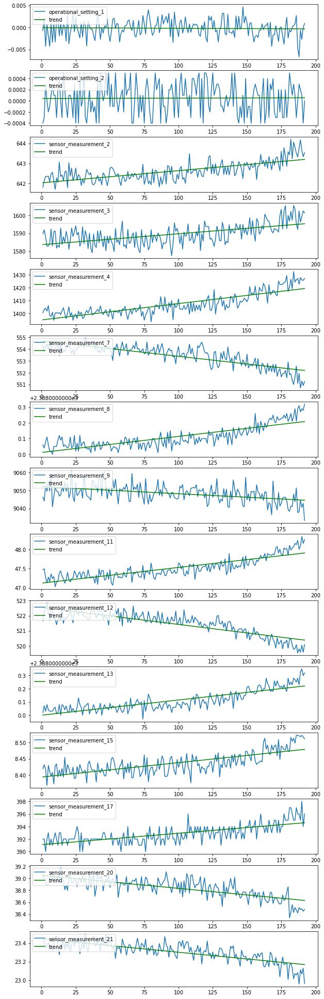

In [58]:
df_1 = df_train_1[df_train_1["ID"]==1]
x = df_1["Cycle"].values.reshape(-1,1)

cols = df_1.columns[2:-1]
fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))
slopes = []
for col, ax in zip(cols, axes):
    linear = LinearRegression()
    y = df_1[col].values.reshape(-1,1)
    linear.fit(x,y)
    preds = linear.predict(x)
    ax.plot(x,y, label=col)
    ax.plot(x,preds,"g",label='trend')
    ax.legend(loc=2)
    slope = linear.coef_
    slopes.append(slope)

In [59]:
slopes_df = pd.DataFrame({"columns": cols, "slope":slopes})
slopes_df["slope"] = slopes_df["slope"].apply(lambda x: abs(x))
slopes_df.sort_values("slope", ascending=False)

,columns,slope
4,sensor_measurement_4,[[0.12702480298673466]]
3,sensor_measurement_3,[[0.060471085505791805]]
7,sensor_measurement_9,[[0.0390974350975231]]
12,sensor_measurement_17,[[0.01820931557388168]]
5,sensor_measurement_7,[[0.013082757439709209]]
9,sensor_measurement_12,[[0.011305585885576272]]
2,sensor_measurement_2,[[0.0060736036133792835]]
8,sensor_measurement_11,[[0.0040663741420937025]]
13,sensor_measurement_20,[[0.002193366315818032]]
14,sensor_measurement_21,[[0.001443742963811955]]


At this point, the slopes of each sensor have been plotted, their single trend value has been calculated and sorte, focusing in the top 10 features by slope importance. These 10 top features have been selected as columns of the new dataset. It comes now the moment to test this step

In [60]:
top_10_features_df = slopes_df.sort_values("slope", ascending=False).head(10)
top_10_features = top_10_features_df["columns"].values.tolist()

df_train_1_top = df_train_1[["ID", "Cycle"]+top_10_features+["RUL"]]
df_train_1_top.head()

,ID,Cycle,sensor_measurement_4,sensor_measurement_3,sensor_measurement_9,sensor_measurement_17,sensor_measurement_7,sensor_measurement_12,sensor_measurement_2,sensor_measurement_11,sensor_measurement_20,sensor_measurement_21,RUL
0,1,1,1400.60,1589.70,9046.19,392,554.36,521.66,641.82,47.47,39.06,23.4190,191
1,1,2,1403.14,1591.82,9044.07,392,553.75,522.28,642.15,47.49,39.00,23.4236,190
2,1,3,1404.20,1587.99,9052.94,390,554.26,522.42,642.35,47.27,38.95,23.3442,189
3,1,4,1401.87,1582.79,9049.48,392,554.45,522.86,642.35,47.13,38.88,23.3739,188
4,1,5,1406.22,1582.85,9055.15,393,554.00,522.19,642.37,47.28,38.90,23.4044,187


In [61]:
X_train_top = df_train_1_top.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_top = df_train_1_top["RUL"]

df_test_1_top = df_test_1[["ID", "Cycle"]+top_10_features]
df_test_1_red = df_test_1_top.groupby("ID").last().reset_index()
X_test_top = df_test_1_red.drop(columns=["ID","Cycle",], axis=1)
y_test = df_RUL_1

### Linear Regressor + Top Features

In [62]:
lr = LinearRegression()
lr.fit(X_train_top, y_train_top)

LinearRegression()

In [63]:
preds_y_train_top = lr.predict(X_train_top)
print("LR top10 features TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_top,preds_y_train_top), "\n",
      "MSE: ", mean_squared_error(y_train_top, preds_y_train_top), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_top, preds_y_train_top)), "\n",
      "R2 score: ", r2_score(y_train_top, preds_y_train_top))
lr_top_TR_score = r2_score(y_train_top, preds_y_train_top)

LR top10 features TRAIN SCORES - - - -  
 MAE:  27.73149513243652 
 MSE:  2003.6223462859741 
 RMSE:  44.76184029154715 
 R2 score:  0.5776833979495908


In [64]:
preds_y_test_top = lr.predict(X_test_top)
print("LR top10 features TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_y_test_top), "\n",
      "MSE: ", mean_squared_error(y_test, preds_y_test_top), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_y_test_top)), "\n",
      "R2 score: ", r2_score(y_test, preds_y_test_top))
lr_top_TS_score = r2_score(y_test, preds_y_test_top)

LR top10 features TEST SCORES - - - -  
 MAE:  20.242489415096315 
 MSE:  1058.5571404763211 
 RMSE:  32.53547510758558 
 R2 score:  0.38700806333244764


Both train and test scores were slightly reduced

### Random Forest Regressor + Top Features

In [65]:
regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train_top, y_train_top)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_train_top, y_train_top)

RandomForestRegressor(max_depth=9, min_samples_leaf=10, n_estimators=64)

In [66]:
rul_train_pred_rf = hyper_regr.predict(X_train_top)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_top, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train_top, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_top, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train_top, rul_train_pred_rf))
rf_top_TR_score = r2_score(y_train_top, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  18.757999317796163 
 MSE:  1545.1389669313478 
 RMSE:  39.308255709600594 
 R2 score:  0.6743209420579148


In [67]:
rul_test_pred_rf = hyper_regr.predict(X_test_top)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))
rf_top_TS_score = r2_score(y_test, rul_test_pred_rf)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  17.729364426723265 
 MSE:  1062.947698436746 
 RMSE:  32.60287868328111 
 R2 score:  0.3844655679637038


As well, both train and test scores have been reduced

### SVR + Top Features

In [68]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
regr.fit(X_train_top, y_train_top)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [69]:
svr_preds_train = regr.predict(X_train_top)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_top, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_train_top, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_top, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_train_top, svr_preds_train))
svr_top_TR_score = r2_score(y_train_top, svr_preds_train)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  20.26709058635724 
 MSE:  1813.6239511487545 
 RMSE:  42.58666400586872 
 R2 score:  0.6177306038405204


In [70]:
svr_preds_test = regr.predict(X_test_top)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(y_test, svr_preds_test))
svr_top_TS_score = r2_score(y_test, svr_preds_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  10.826930757683982 
 MSE:  772.6007511988772 
 RMSE:  27.795696630933307 
 R2 score:  0.5526004098984212


The number of top features was initially fixed at 10, but what would happen if this number varies throughout a selected range? What would happen if the top features number selected in the new dataframe fluctuates?

### Linear Regression + Top Features Variation

In [71]:
columns = slopes_df.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]
train_scores = []
test_scores = []
for col in columns:
    
    column.append(col) # the number of columns in the model will be one by one increasing
    df = df_train_1[["ID","Cycle"]+column]
    X_train = df.drop(columns=["ID","Cycle"], axis=1)    
    y_train = df_train_1["RUL"]
    df_test = df_test_1[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_1
    
    lr = LinearRegression()
    lr.fit(X_train, y_train)
    
    preds_train = lr.predict(X_train)
    r2_tr = r2_score(y_train, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} top features: ".format(len(column)), r2_score(y_train, preds_train))
    
    preds_test = lr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} top features: ".format(len(column)), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 1 top features:  0.4609707036180324
 TEST SCORE WITH 1 top features:  0.15130228427217318
 TRAIN SCORE WITH 2 top features:  0.48941780510839317
 TEST SCORE WITH 2 top features:  0.20592391116165287
 TRAIN SCORE WITH 3 top features:  0.5184902903223743
 TEST SCORE WITH 3 top features:  0.20139244533592826
 TRAIN SCORE WITH 4 top features:  0.5329771664052765
 TEST SCORE WITH 4 top features:  0.2497272429920857
 TRAIN SCORE WITH 5 top features:  0.5526946714596211
 TEST SCORE WITH 5 top features:  0.2766598038653212
 TRAIN SCORE WITH 6 top features:  0.564982434195084
 TEST SCORE WITH 6 top features:  0.29386965698148015
 TRAIN SCORE WITH 7 top features:  0.5679576093991513
 TEST SCORE WITH 7 top features:  0.32302466207357283
 TRAIN SCORE WITH 8 top features:  0.5746034186011502
 TEST SCORE WITH 8 top features:  0.3489999741727705
 TRAIN SCORE WITH 9 top features:  0.5760456909745708
 TEST SCORE WITH 9 top features:  0.36366622824772543
 TRAIN SCORE WITH 10 top featur

Train Score from max Test Score:  0.5791177107952363 
 Max Test Score:  0.3994385598171166 
 Achieved with 12 features out of 15


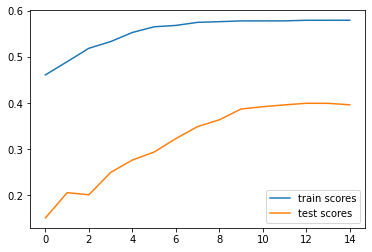

In [72]:
plt.plot(range(0,len(column)),train_scores,label="train scores")
plt.plot(range(0,len(column)), test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} features out of 15".format(mx_idx))

lr_vartop_TR_score = train_mx_test
lr_vartop_TS_score = mx_test

Slight increase from top feature and very slight increase in test score from baseline model. Shall we use from now on 12 out of 15 features?

### Random Forest Regressor + Top Features Variation

In [74]:
columns = slopes_df.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]
train_scores = []
test_scores = []
for col in columns:
    
    column.append(col) # the number of columns in the model will be one by one increasing
    df = df_train_1[["ID","Cycle"]+column]
    X_train = df.drop(columns=["ID","Cycle"], axis=1)    
    y_train = df_train_1["RUL"]
    df_test = df_test_1[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_1
    
    regr = RandomForestRegressor()
    rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
    rf_random.fit(X_train_top, y_train_top)

    n_estimators = list(rf_random.best_params_.values())[0]
    max_depth = list(rf_random.best_params_.values())[1]
    min_samples_leaf = list(rf_random.best_params_.values())[2]

    hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
    hyper_regr.fit(X_train, y_train)
    
    preds_train = hyper_regr.predict(X_train)
    r2_tr = r2_score(y_train, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} top features: ".format(len(column)), r2_score(y_train, preds_train))
    
    preds_test = hyper_regr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} top features: ".format(len(column)), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 1 top features:  0.4785083683911825
 TEST SCORE WITH 1 top features:  0.17405755918333643
 TRAIN SCORE WITH 2 top features:  0.5401508172882803
 TEST SCORE WITH 2 top features:  0.25102432377546313
 TRAIN SCORE WITH 3 top features:  0.6054621717611929
 TEST SCORE WITH 3 top features:  0.23749711434778864
 TRAIN SCORE WITH 4 top features:  0.6184813881067523
 TEST SCORE WITH 4 top features:  0.3248260946324453
 TRAIN SCORE WITH 5 top features:  0.5874671129704385
 TEST SCORE WITH 5 top features:  0.3836501997952585
 TRAIN SCORE WITH 6 top features:  0.6552612697133469
 TEST SCORE WITH 6 top features:  0.28706297711388395
 TRAIN SCORE WITH 7 top features:  0.6605500485837137
 TEST SCORE WITH 7 top features:  0.32223755946080146
 TRAIN SCORE WITH 8 top features:  0.6693366861608592
 TEST SCORE WITH 8 top features:  0.32364438217936486
 TRAIN SCORE WITH 9 top features:  0.6719506601446357
 TEST SCORE WITH 9 top features:  0.3565698989787167
 TRAIN SCORE WITH 10 top featur

Train Score from max Test Score:  0.6804065932666001 
 Max Test Score:  0.3969872519003438 
 Achieved with 12 features out of 15


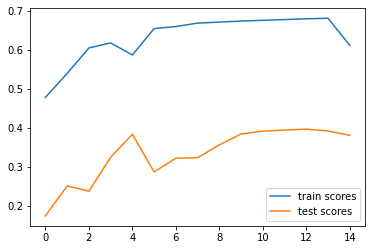

In [75]:
plt.plot(range(0,len(column)),train_scores,label="train scores")
plt.plot(range(0,len(column)), test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} features out of 15".format(mx_idx))

### SVR + Top Features Variation

In [77]:
columns = slopes_df.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]
train_scores = []
test_scores = []
for col in columns:
    
    column.append(col) # the number of columns in the model will be one by one increasing
    df = df_train_1[["ID","Cycle"]+column]
    X_train = df.drop(columns=["ID","Cycle"], axis=1)    
    y_train = df_train_1["RUL"]
    df_test = df_test_1[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_1
    
    regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
    regr.fit(X_train, y_train)
    
    preds_train = regr.predict(X_train)
    r2_tr = r2_score(y_train, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} top features: ".format(len(column)), r2_score(y_train, preds_train))
    
    preds_test = regr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} top features: ".format(len(column)), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 1 top features:  0.4607558008849225
 TEST SCORE WITH 1 top features:  0.34481683288128273
 TRAIN SCORE WITH 2 top features:  0.48786279332260796
 TEST SCORE WITH 2 top features:  0.3899256794745628
 TRAIN SCORE WITH 3 top features:  0.5605765448400024
 TEST SCORE WITH 3 top features:  0.39354390050834054
 TRAIN SCORE WITH 4 top features:  0.5730833529474849
 TEST SCORE WITH 4 top features:  0.438114398560813
 TRAIN SCORE WITH 5 top features:  0.5915863070983334
 TEST SCORE WITH 5 top features:  0.44034995198932836
 TRAIN SCORE WITH 6 top features:  0.6050968091843053
 TEST SCORE WITH 6 top features:  0.4489833926406356
 TRAIN SCORE WITH 7 top features:  0.6065532888987304
 TEST SCORE WITH 7 top features:  0.47271750194625217
 TRAIN SCORE WITH 8 top features:  0.6148839764895029
 TEST SCORE WITH 8 top features:  0.4991921102362843
 TRAIN SCORE WITH 9 top features:  0.6155386125620923
 TEST SCORE WITH 9 top features:  0.5105986989342672
 TRAIN SCORE WITH 10 top features

Train Score from max Test Score:  0.6147592385327965 
 Max Test Score:  0.5974072326834532 
 Achieved with 14 features out of 15


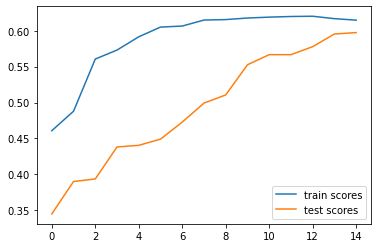

In [79]:
plt.plot(range(0,len(column)),train_scores,label="train scores")
plt.plot(range(0,len(column)), test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} features out of 15".format(mx_idx))
svr_vartop_TR_score = train_mx_test
svr_vartop_TS_score = mx_test

In the three models it has been notices that, selecting specific number of top features for each case, better metrics are obtained.

## Delimiting the RUL

If it is reviewed the sensors performance plots, it is observed that the evolution of these sensors is not linear with time, it means that the sensors which behaviour faces an increasing trend, it does not perform such that since the very begining, but takes some cycles to start the trend.

The plots below show how the RUL decreasing does not match with the trend of each sensor, which start at some point to increase/decrease. In green, the first value achieved by each sensor shows (with higher or lower accuracy) how far it goes the trend at some point, mostly, when engine's life is above the middle of the performance

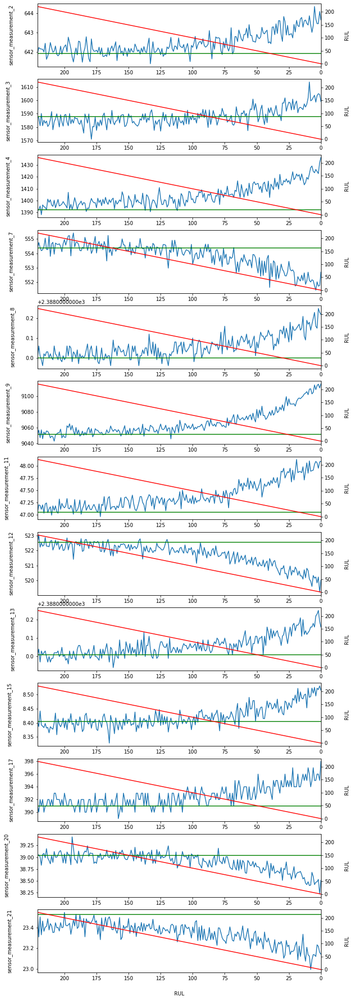

In [80]:
df_10 = df_train_1[df_train_1['ID']==10]
cols = df_10.columns[4:-1]

fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))

for col, ax in zip(cols, axes):

    ax.plot(df_10["RUL"], df_10[col])
    plt.xlim(df_10["RUL"].iloc[0],0)
    ax2 = ax.twinx()
    ax2.plot(df_10["RUL"], df_10["RUL"], "r")
    
    ax.set_ylabel('{}'.format(col), labelpad=20)
    ax.set_xlabel('RUL', labelpad=20)
    ax2.set_ylabel('RUL', labelpad=20)

    ax.plot(df_10["RUL"], np.full(df_10.shape[0],df_10[col].iloc[0]), "g")

The intention at this point is, somehow, ease the model by delimiting the RUL at some point, by matching the start of decreasing with the moment when the sensor starts to modify its trend. Hence, RUL will be constant until that certain cycle.

At first sight, from the plots above, it is easy to detect that the moment when sensors start to vary their trends is around RUL's domain of 150-100.
For a starting point, it will be fixed an upper clip of 125 cycles left

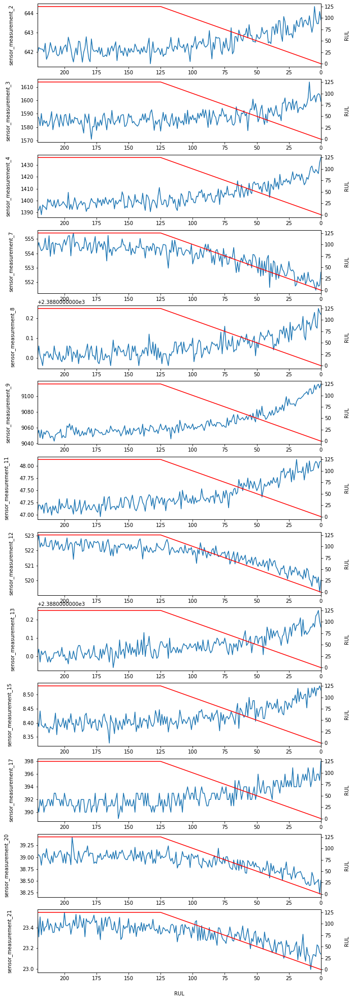

In [81]:
rul_clipped = df_10["RUL"].clip(upper=125)
fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))

for col, ax in zip(cols, axes):

    ax.plot(df_10["RUL"], df_10[col])
    plt.xlim(df_10["RUL"].iloc[0],0)
    ax2 = ax.twinx()
    ax2.plot(df_10["RUL"], rul_clipped, "r")
    
    ax.set_ylabel('{}'.format(col), labelpad=20)
    ax.set_xlabel('RUL', labelpad=20)
    ax2.set_ylabel('RUL', labelpad=20)


In the above plots, it is visible how related is the moment when RUL starts to decrease with the moment when sensors start to modify their trend. Let's fit this modification in the models

In [82]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=125)

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

### Linear Regression + RUL clip

In [83]:
lr = LinearRegression()
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=125)

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
lr.fit(X_train, y_train_clip)

LinearRegression()

In [84]:
preds_train_clip = lr.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
lr_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  15.529491067980416 
 MSE:  462.9193937794556 
 RMSE:  21.515561665442426 
 R2 score:  0.7334354893554875


In [85]:
preds_test = lr.predict(X_test)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
lr_clip_TS_score = r2_score(y_test, preds_test)

TRAIN SCORES - - - -  
 MAE:  14.887298285699217 
 MSE:  487.5299250942147 
 RMSE:  22.080079825358755 
 R2 score:  0.7176799423105168


#### With 12/15 top features

In [87]:
lr = LinearRegression()
df = df_train_1[["ID","Cycle"]+columns[:12]]
X_train = df.drop(columns=["ID","Cycle"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=125)
dft = df_test_1[["ID","Cycle"]+columns[:12]]
df_test_1_red = dft.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
lr.fit(X_train, y_train_clip)

LinearRegression()

In [88]:
preds_train_clip = lr.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
lr_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  15.600923907550168 
 MSE:  466.17662969248073 
 RMSE:  21.591123863580624 
 R2 score:  0.731559863687441


In [89]:
preds_test = lr.predict(X_test)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
lr_clip_TS_score = r2_score(y_test, preds_test)

TRAIN SCORES - - - -  
 MAE:  14.417027020717796 
 MSE:  479.9682734106362 
 RMSE:  21.908178231213935 
 R2 score:  0.7220587626242095


Huge improvement in both train and test scores.

### Random Forest Regressor + RUL clipped

In [90]:
regr = RandomForestRegressor()
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=120)

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train, y_train_clip)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_train, y_train_clip)

RandomForestRegressor(max_depth=5, min_samples_leaf=10, n_estimators=70)

In [91]:
rul_train_pred_rf = hyper_regr.predict(X_train)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train_clip, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train_clip, rul_train_pred_rf))
rf_clip_TR_score = r2_score(y_train_clip, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  10.65708568700903 
 MSE:  325.50140585977266 
 RMSE:  18.04165751420231 
 R2 score:  0.7951006300216916


In [92]:
rul_test_pred_rf = hyper_regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))
rf_clip_TS_score = r2_score(y_test, rul_test_pred_rf)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  11.186147772946399 
 MSE:  382.8433738083859 
 RMSE:  19.566383769321963 
 R2 score:  0.7783020942586597


#### With 11/15 features

In [93]:
regr = RandomForestRegressor()
df = df_train_1[["ID","Cycle"]+columns[:11]]
X_train = df.drop(columns=["ID","Cycle"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=120)
dft = df_test_1[["ID","Cycle"]+columns[:11]]
df_test_1_red = dft.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train, y_train_clip)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_train, y_train_clip)

RandomForestRegressor(max_depth=9, min_samples_leaf=10, n_estimators=64)

In [94]:
rul_train_pred_rf = hyper_regr.predict(X_train)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train_clip, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train_clip, rul_train_pred_rf))
rf_clip_TR_score = r2_score(y_train_clip, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  8.130654736883443 
 MSE:  244.1502224146975 
 RMSE:  15.625307114252108 
 R2 score:  0.8463102590273085


In [95]:
rul_test_pred_rf = hyper_regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))
rf_clip_TS_score = r2_score(y_test, rul_test_pred_rf)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  9.873498164921386 
 MSE:  338.6208347192432 
 RMSE:  18.40165304311662 
 R2 score:  0.8039105936434092


Even higher improvement from baseline model, compared to Linear Regression

### SVR + RUL clipped

In [96]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=115)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

regr.fit(X_train, y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [97]:
svr_preds_train = regr.predict(X_train)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_train_clip, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_train_clip, svr_preds_train))
svr_clip_TR_score = r2_score(y_train_clip, svr_preds_train)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  6.112133498710591 
 MSE:  271.3594980910026 
 RMSE:  16.472992991287363 
 R2 score:  0.8121014574002057


In [98]:
svr_preds_test = regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(y_test, svr_preds_test))
svr_clip_TS_score = r2_score(y_test, svr_preds_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  8.59298918180415 
 MSE:  346.36048720590554 
 RMSE:  18.610762671258414 
 R2 score:  0.7994286961760717


#### With 14/15 top features

In [99]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))

df = df_train_1[["ID","Cycle"]+columns[:14]] # max R2 by SVR is achieved with 14/15 top features
X_train = df.drop(columns=["ID","Cycle"], axis=1)    
y_train = df_train_1["RUL"].clip(upper=115)
df_test = df_test_1[["ID", "Cycle"]+columns[:14]]
df_test_red = df_test.groupby("ID").last().reset_index()
X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

regr.fit(X_train, y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [100]:
svr_preds_train = regr.predict(X_train)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_train_clip, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_train_clip, svr_preds_train))
svr_clip_TR_score = r2_score(y_train_clip, svr_preds_train)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  5.89848041508148 
 MSE:  270.8584389925463 
 RMSE:  16.457777462116393 
 R2 score:  0.8124484077557991


In [101]:
svr_preds_test = regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(y_test, svr_preds_test))
svr_clip_TS_score = r2_score(y_test, svr_preds_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  7.8043063516231115 
 MSE:  343.6376748017501 
 RMSE:  18.53746678491293 
 R2 score:  0.8010054292450628


So far, best model

- Initially constant RUL correlates better with the initially practically constant sensor' signals
- Lower peaks of RUL values results in lower spread of this target variable, and hence, makes easier to fit in the model

However, this initial upper clip was initially selected "at sight", and similarly to the top features, it is possible to find a better solution. Now the upper clip which provides the best metrics will be searched

### Linear Regression + RUL clipped Variation

In [102]:
clips = np.arange(100,205,5).tolist()
train_scores = []
test_scores = []

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)


    lr = LinearRegression()
    lr.fit(X_train, y_train_clip)
    preds_train = lr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = lr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.7538452630159777
 TEST SCORE WITH 100 upper clipped RUL:  0.6497577524726327
 TRAIN SCORE WITH 105 upper clipped RUL:  0.751424050754329
 TEST SCORE WITH 105 upper clipped RUL:  0.6784327609585714
 TRAIN SCORE WITH 110 upper clipped RUL:  0.7480231120977361
 TEST SCORE WITH 110 upper clipped RUL:  0.6987008602585735
 TRAIN SCORE WITH 115 upper clipped RUL:  0.743795938339449
 TEST SCORE WITH 115 upper clipped RUL:  0.7113779460520386
 TRAIN SCORE WITH 120 upper clipped RUL:  0.7389203103806541
 TEST SCORE WITH 120 upper clipped RUL:  0.7173946953186465
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7334354893554875
 TEST SCORE WITH 125 upper clipped RUL:  0.7176799423105168
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7274807824189331
 TEST SCORE WITH 130 upper clipped RUL:  0.7131758824220329
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7211150695771396
 TEST SCORE WITH 135 upper clipped RUL:  0.7046814873463982
 TRAIN SCORE WITH 140 upper clippe

Train Score from max Test Score:  0.7334354893554875 
 Max Test Score:  0.7176799423105168 
 Achieved with 125 upper clipped RUL


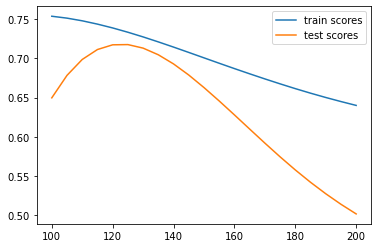

In [103]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_TR_score = train_mx_test
lr_varclip_TS_score = mx_test

#### With top 12/15

In [104]:
clips = np.arange(100,205,5).tolist()
train_scores = []
test_scores = []
df = df_train_1[["ID","Cycle"]+columns[:12]] # max R2 by SVR is achieved with 14/15 top features
X_train = df.drop(columns=["ID","Cycle"], axis=1)    
df_test = df_test_1[["ID", "Cycle"]+columns[:12]]
df_test_red = df_test.groupby("ID").last().reset_index()
X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)


    lr = LinearRegression()
    lr.fit(X_train, y_train_clip)
    preds_train = lr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = lr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.7518195208213196
 TEST SCORE WITH 100 upper clipped RUL:  0.6561143792701503
 TRAIN SCORE WITH 105 upper clipped RUL:  0.7494075358191739
 TEST SCORE WITH 105 upper clipped RUL:  0.6844753330262133
 TRAIN SCORE WITH 110 upper clipped RUL:  0.7460374409267521
 TEST SCORE WITH 110 upper clipped RUL:  0.7043454329634641
 TRAIN SCORE WITH 115 upper clipped RUL:  0.7418525369028521
 TEST SCORE WITH 115 upper clipped RUL:  0.7165905460555553
 TRAIN SCORE WITH 120 upper clipped RUL:  0.7370113007464004
 TEST SCORE WITH 120 upper clipped RUL:  0.7221952356845288
 TRAIN SCORE WITH 125 upper clipped RUL:  0.731559863687441
 TEST SCORE WITH 125 upper clipped RUL:  0.7220587626242095
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7256484989008984
 TEST SCORE WITH 130 upper clipped RUL:  0.717111248335975
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7193191289491182
 TEST SCORE WITH 135 upper clipped RUL:  0.7081774650257047
 TRAIN SCORE WITH 140 upper clippe

Train Score from max Test Score:  0.7370113007464004 
 Max Test Score:  0.7221952356845288 
 Achieved with 120 upper clipped RUL


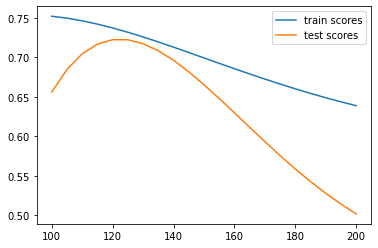

In [105]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_TR_score = train_mx_test
lr_varclip_TS_score = mx_test

### Random Forest Regressor + RUL clipped variation

In [107]:
clips = np.arange(120,155,5).tolist()
train_scores = []
test_scores = []

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)


    regr = RandomForestRegressor()
    rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
    rf_random.fit(X_train_top, y_train_top)

    n_estimators = list(rf_random.best_params_.values())[0]
    max_depth = list(rf_random.best_params_.values())[1]
    min_samples_leaf = list(rf_random.best_params_.values())[2]

    hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
    hyper_regr.fit(X_train, y_train_clip)
    
    preds_train = hyper_regr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = hyper_regr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 120 upper clipped RUL:  0.795861838593407
 TEST SCORE WITH 120 upper clipped RUL:  0.7788075852721981
 TRAIN SCORE WITH 125 upper clipped RUL:  0.786602317299902
 TEST SCORE WITH 125 upper clipped RUL:  0.7768208532265856
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8317160477687705
 TEST SCORE WITH 130 upper clipped RUL:  0.7846488057987547
 TRAIN SCORE WITH 135 upper clipped RUL:  0.8243570616492857
 TEST SCORE WITH 135 upper clipped RUL:  0.7777060543266963
 TRAIN SCORE WITH 140 upper clipped RUL:  0.8172638058530238
 TEST SCORE WITH 140 upper clipped RUL:  0.7614521933254796
 TRAIN SCORE WITH 145 upper clipped RUL:  0.8101287325826418
 TEST SCORE WITH 145 upper clipped RUL:  0.738657050912248
 TRAIN SCORE WITH 150 upper clipped RUL:  0.7431124070844205
 TEST SCORE WITH 150 upper clipped RUL:  0.7086301320469455


Train Score from max Test Score:  0.8317160477687705 
 Max Test Score:  0.7846488057987547 
 Achieved with 130 upper clipped RUL


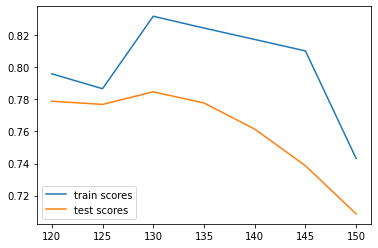

In [108]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
rf_varclip_TR_score = train_mx_test
rf_varclip_TS_score = mx_test

#### With 11/15 features

In [109]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

df = df_train_1[["ID","Cycle"]+columns[:11]] # max R2 by SVR is achieved with 14/15 top features
X_train = df.drop(columns=["ID","Cycle"], axis=1)    
df_test = df_test_1[["ID", "Cycle"]+columns[:11]]
df_test_red = df_test.groupby("ID").last().reset_index()
X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)


    regr = RandomForestRegressor()
    rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
    rf_random.fit(X_train, y_train_clip)

    n_estimators = list(rf_random.best_params_.values())[0]
    max_depth = list(rf_random.best_params_.values())[1]
    min_samples_leaf = list(rf_random.best_params_.values())[2]

    hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
    hyper_regr.fit(X_train, y_train_clip)
    
    preds_train = hyper_regr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = hyper_regr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8259404244379023
 TEST SCORE WITH 100 upper clipped RUL:  0.7244031003777265
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8636240650635164
 TEST SCORE WITH 105 upper clipped RUL:  0.7765708358518386
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8098322225790111
 TEST SCORE WITH 110 upper clipped RUL:  0.762310709405698
 TRAIN SCORE WITH 115 upper clipped RUL:  0.80291990739295
 TEST SCORE WITH 115 upper clipped RUL:  0.7737864415508147
 TRAIN SCORE WITH 120 upper clipped RUL:  0.7950422338500454
 TEST SCORE WITH 120 upper clipped RUL:  0.7824975384184795
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8356520989631885
 TEST SCORE WITH 125 upper clipped RUL:  0.7970407645565291
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7766147858086814
 TEST SCORE WITH 130 upper clipped RUL:  0.7649558363712465
 TRAIN SCORE WITH 135 upper clipped RUL:  0.768854262879944
 TEST SCORE WITH 135 upper clipped RUL:  0.7610706252677331
 TRAIN SCORE WITH 140 upper clipped 

Train Score from max Test Score:  0.8356520989631885 
 Max Test Score:  0.7970407645565291 
 Achieved with 125 upper clipped RUL


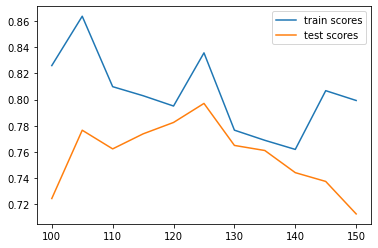

In [110]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
rf_varclip_TR_score = train_mx_test
rf_varclip_TS_score = mx_test

### SVR + RUL Clipped Variation

In [111]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)


    regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
    regr.fit(X_train, y_train_clip)
    
    preds_train = regr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = regr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8339046495440126
 TEST SCORE WITH 100 upper clipped RUL:  0.7691559002592063
 TRAIN SCORE WITH 105 upper clipped RUL:  0.826647127524291
 TEST SCORE WITH 105 upper clipped RUL:  0.7889354064661155
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8194033811906325
 TEST SCORE WITH 110 upper clipped RUL:  0.7983758669233326
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8121014574002057
 TEST SCORE WITH 115 upper clipped RUL:  0.7994286961760717
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8046248208858525
 TEST SCORE WITH 120 upper clipped RUL:  0.7934612469340628
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7970105496897593
 TEST SCORE WITH 125 upper clipped RUL:  0.7791046468542874
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7891792920246239
 TEST SCORE WITH 130 upper clipped RUL:  0.7608309703246907
 TRAIN SCORE WITH 135 upper clipped RUL:  0.782039010581335
 TEST SCORE WITH 135 upper clipped RUL:  0.7420790128039266
 TRAIN SCORE WITH 140 upper clippe

Train Score from max Test Score:  0.8121014574002057 
 Max Test Score:  0.7994286961760717 
 Achieved with 115 upper clipped RUL


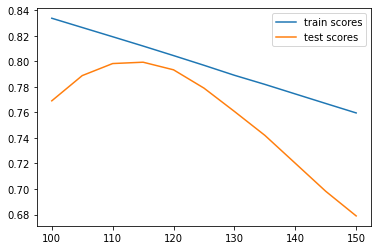

In [112]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
svr_varclip_TR_score = train_mx_test
svr_varclip_TS_score = mx_test

#### With top 14/15 features

In [113]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []
df = df_train_1[["ID","Cycle"]+columns[:14]] # max R2 by SVR is achieved with 14/15 top features
X_train = df.drop(columns=["ID","Cycle"], axis=1)    
df_test = df_test_1[["ID", "Cycle"]+columns[:14]]
df_test_red = df_test.groupby("ID").last().reset_index()
X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)


    regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
    regr.fit(X_train, y_train_clip)
    
    preds_train = regr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = regr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8346197809746871
 TEST SCORE WITH 100 upper clipped RUL:  0.7714030423347493
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8272670534129212
 TEST SCORE WITH 105 upper clipped RUL:  0.7911112024368093
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8198113452587454
 TEST SCORE WITH 110 upper clipped RUL:  0.7999558583990457
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8124484077557991
 TEST SCORE WITH 115 upper clipped RUL:  0.8010054292450628
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8048891048580371
 TEST SCORE WITH 120 upper clipped RUL:  0.7945578715953241
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7970367796511058
 TEST SCORE WITH 125 upper clipped RUL:  0.7802388643830251
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7895574745853071
 TEST SCORE WITH 130 upper clipped RUL:  0.7616096793553088
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7822390685467507
 TEST SCORE WITH 135 upper clipped RUL:  0.741273825567475
 TRAIN SCORE WITH 140 upper clipp

Train Score from max Test Score:  0.8124484077557991 
 Max Test Score:  0.8010054292450628 
 Achieved with 115 upper clipped RUL


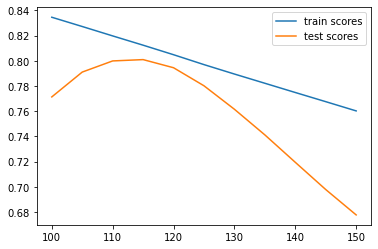

In [114]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
svr_varclip_TR_score = train_mx_test
svr_varclip_TS_score = mx_test

In some articles and papers is exposed the work path of simplify the dataset by the combination (or fusion) of several features in one. With this, it will be reduced the complexity of the dataset, and the accuracy might be higher. Let's introduce the PCA

## Principal Component Analysis

A way to reduce dimensionaly by the linear combination of the dataset features, developing the known as "principal components"

In [9]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=125)

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

In [10]:
pca_pipe = make_pipeline(StandardScaler(), PCA())
pca_pipe.fit(X_train)
pca_model = pca_pipe.named_steps['pca']

list_of_components = []
for number in np.arange(1,len(pca_model.components_)+1):
    component = "PC"+str(number)
    list_of_components.append(component)

In [11]:
# Create a dataframe to visualize the importance of each vector of loading
pd.DataFrame(data=pca_model.components_,columns = X_train.columns,index=list_of_components)

,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21
PC1,0.002462,0.005246,0.273599,0.259905,0.301572,-0.299463,0.284892,0.098365,0.309957,-0.305629,0.284532,0.287331,0.268957,-0.283050,-0.283975
PC2,-0.020875,-0.061384,0.047451,0.143875,0.032886,0.055224,-0.327260,0.848626,-0.002759,0.067149,-0.330388,0.051177,0.140827,-0.047624,-0.055283
PC3,0.724969,0.686062,0.001833,-0.005837,0.005762,-0.001431,-0.028362,0.045586,0.001953,0.011495,-0.022203,0.006293,0.007175,-0.001141,-0.007839
PC4,-0.687894,0.724825,-0.007713,0.015924,-0.000695,0.001981,-0.006435,0.027960,-0.006536,0.001170,-0.004529,0.001560,0.009165,0.000481,0.011817
PC5,0.017753,0.000052,-0.193449,0.920742,-0.034482,0.023244,0.003345,-0.081622,-0.031348,0.015403,0.001491,-0.079992,-0.290018,0.100401,0.065435
PC6,0.009298,-0.007337,-0.612470,0.086866,-0.027685,-0.020735,0.029853,-0.072319,-0.028999,0.018575,0.031266,-0.030749,0.769612,0.103810,0.060733
PC7,0.004719,0.001682,0.685847,0.179959,-0.096132,0.083728,-0.009418,-0.100192,-0.066883,0.055157,-0.004479,-0.196011,0.426873,0.439889,0.221688
PC8,-0.010243,0.003866,-0.074747,-0.049868,-0.016333,-0.011225,0.008306,0.023038,0.008747,-0.020728,0.016141,-0.110142,-0.070326,0.569996,-0.805031
PC9,0.001235,-0.005134,-0.086787,-0.054922,0.062945,-0.047205,0.036476,0.059152,0.024321,-0.044933,0.016312,0.779105,-0.118347,0.521387,0.287526
PC10,0.003187,-0.002474,-0.145316,-0.128223,0.389284,-0.407124,0.105704,0.237279,0.185637,-0.213166,0.105617,-0.489926,-0.161957,0.319398,0.343992


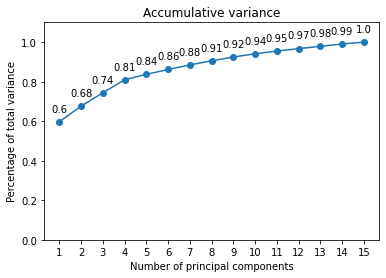

In [12]:
prop_varianza_acum = pca_model.explained_variance_ratio_.cumsum()
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 4))
ax.plot(
    np.arange(len(X_train.columns)) + 1,
    prop_varianza_acum,
    marker = 'o'
)

for x, y in zip(np.arange(len(X_train.columns)) + 1, prop_varianza_acum):
    label = round(y, 2)
    ax.annotate(
        label,
        (x,y),
        textcoords="offset points",
        xytext=(0,10),
        ha='center'
    )
    
ax.set_ylim(0, 1.1)
ax.set_xticks(np.arange(pca_model.n_components_) + 1)
ax.set_title('Accumulative variance')
ax.set_xlabel('Number of principal components')
ax.set_ylabel('Percentage of total variance');

In [13]:
from sklearn.model_selection import GridSearchCV
param_grid = {'pca__n_components': np.arange(1,16).tolist()}

# create gridsearch to find best combination
grid = GridSearchCV(
        estimator  = pca_pipe,
        param_grid = param_grid,
    return_train_score=True)

grid.fit(X_train,y_train_clip)

# check errors
results = pd.DataFrame(grid.cv_results_)
results.filter(regex = '(param.*|mean_t|std_t)') \
    .drop(columns = 'params') \
    .sort_values('mean_test_score', ascending = False)

,param_pca__n_components,mean_test_score,std_test_score,mean_train_score,std_train_score
13,14,-14.781897,0.336053,-14.740576,0.052306
14,15,-14.781897,0.336053,-14.740576,0.052306
12,13,-14.785905,0.335549,-14.744139,0.052612
11,12,-14.787527,0.334851,-14.746039,0.052799
10,11,-14.788716,0.339002,-14.748661,0.052218
9,10,-14.795081,0.337626,-14.756227,0.052024
8,9,-14.820237,0.334114,-14.782057,0.052376
7,8,-14.862876,0.330538,-14.825106,0.051194
6,7,-14.902535,0.323300,-14.865742,0.051625
5,6,-14.958115,0.317342,-14.922004,0.052013


<ipython-input-15-3071d7ecc259>:5: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  ax.fill_between(results.param_pca__n_components.astype(np.float),


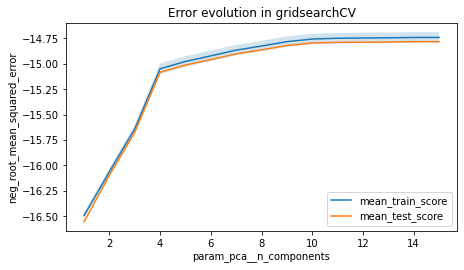

In [15]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 3.84), sharey=True)

results.plot('param_pca__n_components', 'mean_train_score', ax=ax)
results.plot('param_pca__n_components', 'mean_test_score', ax=ax)
ax.fill_between(results.param_pca__n_components.astype(np.float),
                results['mean_train_score'] + results['std_train_score'],
                results['mean_train_score'] - results['std_train_score'],
                alpha=0.2)

ax.legend()
ax.set_title('Error evolution in gridsearchCV')
ax.set_ylabel('neg_root_mean_squared_error');

In [16]:
print("Best number of components found: ", grid.best_params_)

Best number of components found:  {'pca__n_components': 14}


In [130]:
pipe_modelado = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), LinearRegression())
pipe_modelado.fit(X=X_train, y=y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=14)),
                ('linearregression', LinearRegression())])

In [131]:
preds_train_clip = pipe_modelado.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
lr_PCA_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  15.496308493580216 
 MSE:  463.0327805655952 
 RMSE:  21.518196498907503 
 R2 score:  0.7333701974416749


In [132]:
preds_test = pipe_modelado.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
lr_PCA_clip_TS_score = r2_score(y_test, preds_test)

TEST SCORES - - - -  
 MAE:  14.764396489555743 
 MSE:  489.6350557716507 
 RMSE:  22.12769883588555 
 R2 score:  0.716460897932507


With linear regression model, it has been noticed no improvements (neither losses) in terms of accuracy. Let's check other models

### Random Forest Regressor + PCA 

In [133]:
n_estimators = [int(x) for x in np.linspace(start = 1, stop = 100, num = 100)]

max_depth = [int(x) for x in np.linspace(10, 100, num = 10)]
min_samples_leaf = [int(x) for x in np.linspace(start = 5, stop = 20, num = 10)]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
              "min_samples_leaf":min_samples_leaf}

regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train, y_train_clip)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

In [134]:
pipe_modelado = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf))
pipe_modelado.fit(X=X_train, y=y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=14)),
                ('randomforestregressor',
                 RandomForestRegressor(max_depth=8, min_samples_leaf=80,
                                       n_estimators=71))])

In [135]:
preds_train_clip = pipe_modelado.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
rf_PCA_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  10.09760627429165 
 MSE:  318.20275161584675 
 RMSE:  17.838238467288377 
 R2 score:  0.8167681848934887


In [136]:
preds_test = pipe_modelado.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
rf_PCA_clip_TS_score = r2_score(y_test, preds_test)

TEST SCORES - - - -  
 MAE:  7.922125216817484 
 MSE:  338.3927424269487 
 RMSE:  18.39545439577258 
 R2 score:  0.8040426779028661


### SVR + PCA 

In [138]:
pipe_modelado = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), SVR(epsilon=0.2))
pipe_modelado.fit(X=X_train, y=y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=14)), ('svr', SVR(epsilon=0.2))])

In [139]:
preds_train_clip = pipe_modelado.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
svr_PCA_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  8.03042270470317 
 MSE:  352.7494319415433 
 RMSE:  18.781624848280387 
 R2 score:  0.7968750478610855


In [140]:
preds_test = pipe_modelado.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
svr_PCA_clip_TS_score = r2_score(y_test, preds_test)

TEST SCORES - - - -  
 MAE:  9.066348051195781 
 MSE:  384.75158798786913 
 RMSE:  19.61508572471375 
 R2 score:  0.7771970807825506


In this stage, PCA has been testes with a single RUL clipped. The same way as previous featuring steps, now several different upper clips will be chosen to check their impact in the PCA metrics

### Linear Regression + PCA + RUL clipped Variation

In [141]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)
    pipe_model = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), LinearRegression())
    pipe_model.fit(X=X_train, y=y_train_clip)

    preds_train = pipe_model.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = pipe_model.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.7538313521936248
 TEST SCORE WITH 100 upper clipped RUL:  0.6491140520146057
 TRAIN SCORE WITH 105 upper clipped RUL:  0.7514015592910026
 TEST SCORE WITH 105 upper clipped RUL:  0.677625574945559
 TRAIN SCORE WITH 110 upper clipped RUL:  0.7479894530537232
 TEST SCORE WITH 110 upper clipped RUL:  0.697734214220505
 TRAIN SCORE WITH 115 upper clipped RUL:  0.7437515962664618
 TEST SCORE WITH 115 upper clipped RUL:  0.7102981382600306
 TRAIN SCORE WITH 120 upper clipped RUL:  0.738865783864906
 TEST SCORE WITH 120 upper clipped RUL:  0.7162358485568412
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7333701974416749
 TEST SCORE WITH 125 upper clipped RUL:  0.716460897932507
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7274044636106494
 TEST SCORE WITH 130 upper clipped RUL:  0.7119167412573422
 TRAIN SCORE WITH 135 upper clipped RUL:  0.721028314505454
 TEST SCORE WITH 135 upper clipped RUL:  0.703407500731536
 TRAIN SCORE WITH 140 upper clipped RU

Train Score from max Test Score:  0.7333701974416749 
 Max Test Score:  0.716460897932507 
 Achieved with 125 upper clipped RUL


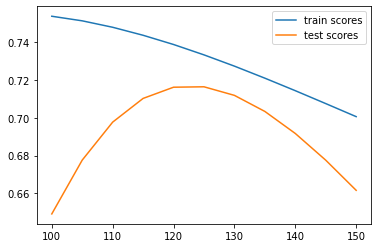

In [142]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_PCA_TR_score = train_mx_test
lr_varclip_PCA_TS_score = mx_test

No news at this stage, Linear regressor were (before PCA introduction) at its best accuracy with 125 RUL clipped, with the use of PCA this has not changed

### Random Forest Regressor + PCA + RUL clipped Variation

In [143]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)
    regr = RandomForestRegressor()
    rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
    rf_random.fit(X_train, y_train_clip)
    n_estimators = list(rf_random.best_params_.values())[0]
    max_depth = list(rf_random.best_params_.values())[1]
    min_samples_leaf = list(rf_random.best_params_.values())[2]
    
    pipe_model = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf))
    pipe_model.fit(X=X_train, y=y_train_clip)
    
    preds_train = pipe_model.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = pipe_model.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8474302702228953
 TEST SCORE WITH 100 upper clipped RUL:  0.7565966390722767
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8524507592475661
 TEST SCORE WITH 105 upper clipped RUL:  0.7814577795116615
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8768384162530883
 TEST SCORE WITH 110 upper clipped RUL:  0.8002035753336327
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8702195667099314
 TEST SCORE WITH 115 upper clipped RUL:  0.8080598121157861
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8313590507584607
 TEST SCORE WITH 120 upper clipped RUL:  0.8087572781619057
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8581559355084927
 TEST SCORE WITH 125 upper clipped RUL:  0.8104571164428893
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8522041466771544
 TEST SCORE WITH 130 upper clipped RUL:  0.7998379303697529
 TRAIN SCORE WITH 135 upper clipped RUL:  0.8461207123800653
 TEST SCORE WITH 135 upper clipped RUL:  0.7892116801747325
 TRAIN SCORE WITH 140 upper clip

Train Score from max Test Score:  0.8581559355084927 
 Max Test Score:  0.8104571164428893 
 Achieved with 125 upper clipped RUL


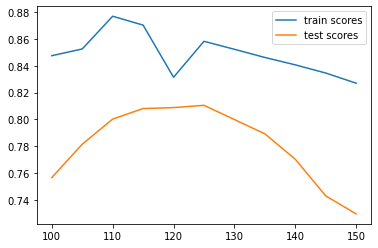

In [144]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
rf_varclip_PCA_TR_score = train_mx_test
rf_varclip_PCA_TS_score = mx_test

Noticed a fairly good improvement for Random Forest

### SVR + PCA + RUL clipped Variation

In [145]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1
for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)
    pipe_model = make_pipeline(StandardScaler(),PCA(n_components=list(grid.best_params_.values())[0]), SVR(epsilon=0.2))
    pipe_model.fit(X=X_train, y=y_train_clip)

    preds_train = pipe_model.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = pipe_model.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8340729743523497
 TEST SCORE WITH 100 upper clipped RUL:  0.770030797939003
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8267510249566112
 TEST SCORE WITH 105 upper clipped RUL:  0.7894461766035255
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8194203264876516
 TEST SCORE WITH 110 upper clipped RUL:  0.7986765997870635
 TRAIN SCORE WITH 115 upper clipped RUL:  0.812084411605407
 TEST SCORE WITH 115 upper clipped RUL:  0.7992138904937213
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8046178759389739
 TEST SCORE WITH 120 upper clipped RUL:  0.7923181335298335
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7968750478610855
 TEST SCORE WITH 125 upper clipped RUL:  0.7771970807825506
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7894859448703497
 TEST SCORE WITH 130 upper clipped RUL:  0.7599234858320855
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7820857021639295
 TEST SCORE WITH 135 upper clipped RUL:  0.740148945960117
 TRAIN SCORE WITH 140 upper clipped

Train Score from max Test Score:  0.812084411605407 
 Max Test Score:  0.7992138904937213 
 Achieved with 115 upper clipped RUL


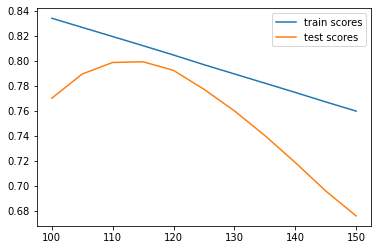

In [146]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
svr_varclip_PCA_TR_score = train_mx_test
svr_varclip_PCA_TS_score = mx_test

SVR however has been left behind with this new inclusion

# Addition of Lagged Variables

Introduction of lagged dataset variables will do the opposite as seen in the PCA featuring, it will introduce far more variables in the study, as it increases the number of features with the inmediate previous value from the inmediate previous cycle

In [148]:
df_train_1_lagg = df_train_1.copy()
sensor_cols = df_train_1.columns[2:len(df_train_1.columns)-1]
lag_cols = []
for col in sensor_cols:
    col = col + "_lag1"
    lag_cols.append(col)
df_train_1_lagg[lag_cols] = df_train_1.groupby("ID")[sensor_cols].shift(1)
df_train_1_lagg.dropna(inplace=True)
df_train_1_lagg

,ID,Cycle,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL,operational_setting_1_lag1,operational_setting_2_lag1,sensor_measurement_2_lag1,sensor_measurement_3_lag1,sensor_measurement_4_lag1,sensor_measurement_7_lag1,sensor_measurement_8_lag1,sensor_measurement_9_lag1,sensor_measurement_11_lag1,sensor_measurement_12_lag1,sensor_measurement_13_lag1,sensor_measurement_15_lag1,sensor_measurement_17_lag1,sensor_measurement_20_lag1,sensor_measurement_21_lag1
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236,190,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392.0,39.06,23.4190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442,189,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392.0,39.00,23.4236
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739,188,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390.0,38.95,23.3442
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044,187,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392.0,38.88,23.3739
5,1,6,-0.0043,-0.0001,642.10,1584.47,1398.37,554.67,2388.02,9049.68,47.16,521.68,2388.03,8.4108,391,38.98,23.3669,186,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393.0,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735,4,-0.0002,-0.0001,643.41,1600.04,1431.90,551.42,2388.23,9069.69,48.22,519.71,2388.28,8.5519,394.0,38.14,23.1923
20627,100,197,-0.0016,-0.0005,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594,3,-0.0004,-0.0003,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397.0,38.49,22.9735
20628,100,198,0.0004,0.0000,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333,2,-0.0016,-0.0005,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395.0,38.30,23.1594
20629,100,199,-0.0011,0.0003,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640,1,0.0004,0.0000,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398.0,38.44,22.9333


In [149]:
df_test_1_lagg = df_test_1.copy()
sensor_cols = df_test_1.columns[2:len(df_train_1.columns)]
lag_cols = []
for col in sensor_cols:
    col = col + "_lag1"
    lag_cols.append(col)
df_test_1_lagg[lag_cols] = df_test_1.groupby("ID")[sensor_cols].shift(1)
df_test_1_lagg.dropna(inplace=True)
df_test_1_lagg

,ID,Cycle,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,operational_setting_1_lag1,operational_setting_2_lag1,sensor_measurement_2_lag1,sensor_measurement_3_lag1,sensor_measurement_4_lag1,sensor_measurement_7_lag1,sensor_measurement_8_lag1,sensor_measurement_9_lag1,sensor_measurement_11_lag1,sensor_measurement_12_lag1,sensor_measurement_13_lag1,sensor_measurement_15_lag1,sensor_measurement_17_lag1,sensor_measurement_20_lag1,sensor_measurement_21_lag1
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8.3803,393,39.02,23.3916,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8.4052,392.0,38.86,23.3735
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8.4441,393,39.08,23.4166,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8.3803,393.0,39.02,23.3916
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8.3917,391,39.00,23.3737,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8.4441,393.0,39.08,23.4166
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8.4031,390,38.99,23.4130,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8.3917,391.0,39.00,23.3737
5,1,6,0.0012,0.0003,642.11,1579.12,1395.13,554.22,2388.00,9050.96,47.26,521.92,2388.08,8.4238,392,38.91,23.3467,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8.4031,390.0,38.99,23.4130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,643.24,1599.45,1415.79,553.41,2388.02,9142.37,47.69,520.69,2388.00,8.4715,394,38.65,23.1974,0.0018,0.0004,643.10,1595.60,1414.62,553.18,2388.08,9139.88,47.58,521.37,2388.05,8.4429,395.0,38.63,23.2952
13092,100,195,-0.0011,-0.0001,643.22,1595.69,1422.05,553.22,2388.05,9140.68,47.60,521.05,2388.09,8.4512,395,38.57,23.2771,0.0049,0.0000,643.24,1599.45,1415.79,553.41,2388.02,9142.37,47.69,520.69,2388.00,8.4715,394.0,38.65,23.1974
13093,100,196,-0.0006,-0.0003,643.44,1593.15,1406.82,553.04,2388.11,9146.81,47.57,521.18,2388.04,8.4569,395,38.62,23.2051,-0.0011,-0.0001,643.22,1595.69,1422.05,553.22,2388.05,9140.68,47.60,521.05,2388.09,8.4512,395.0,38.57,23.2771
13094,100,197,-0.0038,0.0001,643.26,1594.99,1419.36,553.37,2388.07,9148.85,47.61,521.33,2388.08,8.4711,395,38.66,23.2699,-0.0006,-0.0003,643.44,1593.15,1406.82,553.04,2388.11,9146.81,47.57,521.18,2388.04,8.4569,395.0,38.62,23.2051


In [150]:
X_trainL = df_train_1_lagg.drop(columns=["Cycle","RUL"], axis=1)
y_trainL_clip = df_train_1_lagg["RUL"].clip(upper=125)

df_test_1_redL = df_test_1_lagg.groupby("ID").last().reset_index()
X_testL = df_test_1_redL.drop(columns=["Cycle"], axis=1)
y_testL = df_RUL_1

### Linear Regression + Lagged Variables + RUL clipped

In [151]:
lr = LinearRegression()
lr.fit(X_trainL, y_trainL_clip)

LinearRegression()

In [152]:
preds_y_train = lr.predict(X_trainL)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_trainL_clip,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_trainL_clip, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_trainL_clip, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_trainL_clip, preds_y_train))
lr_lagg_clip_TR_score = r2_score(y_trainL_clip, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  15.036687046071165 
 MSE:  445.0981566048498 
 RMSE:  21.097349516108647 
 R2 score:  0.7438933022902241


In [153]:
preds_y_test = lr.predict(X_testL)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_testL, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_testL, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_testL, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_testL, preds_y_test))
lr_lagg_clip_TS_score = r2_score(y_testL, preds_y_test)

TEST SCORES - - - -  
 MAE:  14.764672328146844 
 MSE:  469.4176387641959 
 RMSE:  21.666048065214753 
 R2 score:  0.7281684507248283


Lagged variables provide an increase in both train and test scores for Linear Regression

### Random Forest Regressor + Lagg Variables + RUL clipped

In [154]:
n_estimators = [int(x) for x in np.linspace(start = 1, stop = 100, num = 100)]

max_depth = [int(x) for x in np.linspace(10, 100, num = 10)]
min_samples_leaf = [int(x) for x in np.linspace(start = 5, stop = 20, num = 10)]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
              "min_samples_leaf":min_samples_leaf}

regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_trainL, y_trainL_clip)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_trainL, y_trainL_clip)

RandomForestRegressor(max_depth=13, min_samples_leaf=60, n_estimators=79)

In [155]:
rul_train_pred_rf = hyper_regr.predict(X_trainL)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_trainL_clip, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_trainL_clip, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_trainL_clip, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_trainL_clip, rul_train_pred_rf))
rf_lagg_clip_TR_score = r2_score(y_trainL_clip, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  9.038859404248768 
 MSE:  279.501929341948 
 RMSE:  16.718311198860608 
 R2 score:  0.8391763365786595


In [156]:
rul_test_pred_rf = hyper_regr.predict(X_testL)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))
rf_lagg_clip_TS_score = r2_score(y_test, rul_test_pred_rf)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  10.652872894143819 
 MSE:  352.9691555323248 
 RMSE:  18.78747336744153 
 R2 score:  0.7956017318665376


Even higher improvement from baseline model, compared to Linear Regression

### SVR + RUL clipped

In [157]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
regr.fit(X_trainL, y_trainL_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [158]:
svr_preds_train = regr.predict(X_trainL)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_trainL_clip, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_trainL_clip, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_trainL_clip, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_trainL_clip, svr_preds_train))
svr_lagg_clip_TR_score = r2_score(y_trainL_clip, svr_preds_train)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  7.824046356720487 
 MSE:  333.2535538992789 
 RMSE:  18.2552336029775 
 R2 score:  0.8082479877242852


In [159]:
svr_preds_test = regr.predict(X_testL)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(y_test, svr_preds_test))
svr_lagg_clip_TS_score = r2_score(y_test, svr_preds_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  8.7997596062419 
 MSE:  385.05679849280233 
 RMSE:  19.622864176587534 
 R2 score:  0.7770203387141668


Let's introduce a variable lagging number loop, together again with the RUL limit loop to check if this value might be modifier with this new featuring to obtain better results

#### Linear Regression + Lagg Variation + RUL clipped Variation

In [24]:
df_train_lagg = df_train_1.copy()
sensor_cols = df_train_1.columns[2:len(df_train_1.columns)-1]

laggings = np.arange(1,11).tolist()
best_tr_scores = []
best_ts_scores = []

for number in laggings:
    
    df_train_lagg = df_train_1.copy()
    df_test_lagg = df_test_1.copy()
    lag_cols = []
    
    for col in sensor_cols:
        
        col = col + "_lag1"
        lag_cols.append(col)
        
    df_train_lagg[lag_cols] = df_train_1.groupby("ID")[sensor_cols].shift(number)
    df_train_lagg.dropna(inplace=True)
    
    df_test_lagg[lag_cols] = df_test_1.groupby("ID")[sensor_cols].shift(number)
    df_test_lagg.dropna(inplace=True)
    
    X_trainL = df_train_lagg.drop(columns=["Cycle","RUL"], axis=1)
    df_test_redL = df_test_lagg.groupby("ID").last().reset_index()
    X_testL = df_test_redL.drop(columns=["Cycle"], axis=1)
    y_testL = df_RUL_1
    
    clips = np.arange(100,155,5).tolist()
    train_scores = []
    test_scores = []
    
    for clip in clips:

        y_train_clip = df_train_lagg["RUL"].clip(upper=clip)
        lr = LinearRegression()
        lr.fit(X_trainL, y_train_clip)

        preds_train = lr.predict(X_trainL)
        r2_tr = r2_score(y_train_clip, preds_train)
        train_scores.append(r2_tr)

        preds_test = lr.predict(X_testL)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
    
    mx_test = max(test_scores)
    mx_idx = test_scores.index(mx_test)
    train_mx_test = train_scores[mx_idx]
    top_clip = clips[mx_idx]
    print("best metrics with {} number of lagging are: ".format(number), "\n",
         "train:", train_mx_test, "test", mx_test, "with clip", top_clip)
    best_tr_scores.append(train_mx_test)
    best_ts_scores.append(mx_test)
    

best metrics with 1 number of lagging are:  
 train: 0.7492616236267284 test 0.7285867751823405 with clip 120
best metrics with 2 number of lagging are:  
 train: 0.7419214823861502 test 0.7249456169531348 with clip 125
best metrics with 3 number of lagging are:  
 train: 0.746076245887979 test 0.7256689675479489 with clip 120
best metrics with 4 number of lagging are:  
 train: 0.7451422789614034 test 0.7208587451305697 with clip 120
best metrics with 5 number of lagging are:  
 train: 0.7447072904594536 test 0.7251742204952412 with clip 120
best metrics with 6 number of lagging are:  
 train: 0.7390624131139963 test 0.7252271898693856 with clip 125
best metrics with 7 number of lagging are:  
 train: 0.7393178324749641 test 0.7253743576313367 with clip 125
best metrics with 8 number of lagging are:  
 train: 0.7399411839207549 test 0.7292766644815223 with clip 125
best metrics with 9 number of lagging are:  
 train: 0.7408602534410895 test 0.7342868466263983 with clip 125
best metric

#### Random Forest (fixed parameters) + Lagging variation + clip variation

In [42]:
df_train_lagg = df_train_1.copy()
sensor_cols = df_train_1.columns[2:len(df_train_1.columns)-1]

laggings = np.arange(1,21).tolist()
best_tr_scores = []
best_ts_scores = []

for number in laggings:
    
    df_train_lagg = df_train_1.copy()
    df_test_lagg = df_test_1.copy()
    lag_cols = []
    
    for col in sensor_cols:
        
        col = col + "_lag1"
        lag_cols.append(col)
        
    df_train_lagg[lag_cols] = df_train_1.groupby("ID")[sensor_cols].shift(number)
    df_train_lagg.dropna(inplace=True)
    
    df_test_lagg[lag_cols] = df_test_1.groupby("ID")[sensor_cols].shift(number)
    df_test_lagg.dropna(inplace=True)
    
    X_trainL = df_train_lagg.drop(columns=["Cycle","RUL"], axis=1)
    df_test_redL = df_test_lagg.groupby("ID").last().reset_index()
    X_testL = df_test_redL.drop(columns=["Cycle"], axis=1)
    y_testL = df_RUL_1
    
    clips = np.arange(100,155,5).tolist()
    train_scores = []
    test_scores = []
    
    for clip in clips:

        y_train_clip = df_train_lagg["RUL"].clip(upper=clip)
        n_estimators = 80
        max_depth = 14
        min_samples_leaf = 60

        regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
        regr.fit(X_trainL,y_train_clip)

        preds_train = regr.predict(X_trainL)
        r2_tr = r2_score(y_train_clip, preds_train)
        train_scores.append(r2_tr)

        preds_test = regr.predict(X_testL)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
    mx_test = max(test_scores)
    mx_idx = test_scores.index(mx_test)
    train_mx_test = train_scores[mx_idx]
    top_clip = clips[mx_idx]
    print("best metrics with {} number of lagging are: ".format(number), "\n",
         "train:", train_mx_test, "test", mx_test, "with clip", top_clip)
    best_tr_scores.append(train_mx_test)
    best_ts_scores.append(mx_test)
    

best metrics with 1 number of lagging are:  
 train: 0.8513888456310319 test 0.7987980215014001 with clip 115
best metrics with 2 number of lagging are:  
 train: 0.8425634407400865 test 0.7985716839796758 with clip 120
best metrics with 3 number of lagging are:  
 train: 0.8357382053137813 test 0.7947306997877225 with clip 125
best metrics with 4 number of lagging are:  
 train: 0.8401377355160303 test 0.8028197635874303 with clip 120
best metrics with 5 number of lagging are:  
 train: 0.8396110055786716 test 0.7952582221152878 with clip 120
best metrics with 6 number of lagging are:  
 train: 0.8387129357587177 test 0.793561331587952 with clip 120
best metrics with 7 number of lagging are:  
 train: 0.837714014502014 test 0.7916878566436911 with clip 120
best metrics with 8 number of lagging are:  
 train: 0.8330314246940653 test 0.7931537469479909 with clip 125
best metrics with 9 number of lagging are:  
 train: 0.8367837192550224 test 0.7980808209176513 with clip 120
best metrics

#### SVR Lagg variation + RUL clip variation

In [29]:
df_train_lagg = df_train_1.copy()
sensor_cols = df_train_1.columns[2:len(df_train_1.columns)-1]

laggings = np.arange(1,21).tolist()
best_tr_scores = []
best_ts_scores = []

for number in laggings:
    
    df_train_lagg = df_train_1.copy()
    df_test_lagg = df_test_1.copy()
    lag_cols = []
    
    for col in sensor_cols:
        
        col = col + "_lag1"
        lag_cols.append(col)
        
    df_train_lagg[lag_cols] = df_train_1.groupby("ID")[sensor_cols].shift(number)
    df_train_lagg.dropna(inplace=True)
    
    df_test_lagg[lag_cols] = df_test_1.groupby("ID")[sensor_cols].shift(number)
    df_test_lagg.dropna(inplace=True)
    
    X_trainL = df_train_lagg.drop(columns=["Cycle","RUL"], axis=1)
    df_test_redL = df_test_lagg.groupby("ID").last().reset_index()
    X_testL = df_test_redL.drop(columns=["Cycle"], axis=1)
    y_testL = df_RUL_1
    
    clips = np.arange(100,155,5).tolist()
    train_scores = []
    test_scores = []
    
    for clip in clips:

        y_train_clip = df_train_lagg["RUL"].clip(upper=clip)
        svr = make_pipeline(StandardScaler(),SVR(epsilon=0.2))
        svr.fit(X_trainL, y_train_clip)

        preds_train = svr.predict(X_trainL)
        r2_tr = r2_score(y_train_clip, preds_train)
        train_scores.append(r2_tr)

        preds_test = svr.predict(X_testL)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
    
    mx_test = max(test_scores)
    mx_idx = test_scores.index(mx_test)
    train_mx_test = train_scores[mx_idx]
    top_clip = clips[mx_idx]
    print("best metrics with {} number of lagging are: ".format(number), "\n",
         "train:", train_mx_test, "test", mx_test, "with clip", top_clip)
    best_tr_scores.append(train_mx_test)
    best_ts_scores.append(mx_test)
    

best metrics with 1 number of lagging are:  
 train: 0.8297024571727718 test 0.7978380071846183 with clip 110
best metrics with 2 number of lagging are:  
 train: 0.8204299836122135 test 0.8012974244132551 with clip 115
best metrics with 3 number of lagging are:  
 train: 0.8188433401326943 test 0.7949258507422592 with clip 115
best metrics with 4 number of lagging are:  
 train: 0.8169618337072488 test 0.7948435117407737 with clip 115
best metrics with 5 number of lagging are:  
 train: 0.8157673737502862 test 0.7850165066007982 with clip 115
best metrics with 6 number of lagging are:  
 train: 0.8151119477894067 test 0.7910473900445563 with clip 115
best metrics with 7 number of lagging are:  
 train: 0.8133450766196925 test 0.7857282193026456 with clip 115
best metrics with 8 number of lagging are:  
 train: 0.8133254112668244 test 0.7867827355828306 with clip 115
best metrics with 9 number of lagging are:  
 train: 0.8129234783818161 test 0.7940261850413987 with clip 115
best metri

Fairly good results from these models, best metric achieved by SVR with 0.809. It is important to notice that the highest test score reached by this model was actually more than 0.82, however the train score associated was lower so it was assumed that the model was not performing correctly and that metric was not accurate

# Polynomial Features

Polynomial combination of dataset features sometimes is very useful and provides the revelation of patterns which initially were not obvious. This technique will be applied to each one of the sensors of our datasets

In [10]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1) 
y_train_clip = df_train_1["RUL"].clip(upper=125)

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
                                                           
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_1

In [11]:
# Assume initially the degree of the polynomial expression

polynomial = PolynomialFeatures(2)

X_train_pol = polynomial.fit_transform(X_train)
X_test_pol = polynomial.fit_transform(X_test)

print("X_train columns shape increment: ", "\n",
     "Initially: ", X_train.shape[1]," columns, After polynomial", X_train_pol.shape[1], "columns")

X_train columns shape increment:  
 Initially:  15  columns, After polynomial 136 columns


Dataset has importantly increase in terms of dimensionality with this last featuring

## Linear Regression + Polynomial Features + RUL clipped

In [35]:
lr = LinearRegression()
lr.fit(X_train_pol, y_train_clip)

LinearRegression()

In [36]:
preds_y_train = lr.predict(X_train_pol)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_y_train))
lr_pol_clip_TR_score = r2_score(y_train_clip, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  13.020617485046387 
 MSE:  386.73539660340026 
 RMSE:  19.665589149664452 
 R2 score:  0.7773047897111629


In [37]:
preds_y_test = lr.predict(X_test_pol)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_y_test))
lr_pol_clip_TS_score = r2_score(y_test, preds_y_test)

TEST SCORES - - - -  
 MAE:  11.996847867965698 
 MSE:  411.4325646676223 
 RMSE:  20.283800547915625 
 R2 score:  0.7617465935658243


### Random Forest Regressor + Poly + RUL clipped

In [188]:
n_estimators = [int(x) for x in np.linspace(start = 10, stop = 100, num = 100)]

max_depth = [int(x) for x in np.linspace(10, 100, num = 10)]
min_samples_leaf = [int(x) for x in np.linspace(start = 1, stop = 10, num = 10)]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
              "min_samples_leaf":min_samples_leaf}
print(random_grid)


regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train_pol, y_train_clip)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_train_pol, y_train_clip)

{'n_estimators': [10, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100], 'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]}


RandomForestRegressor(max_depth=9, min_samples_leaf=10, n_estimators=64)

In [189]:
rul_train_pred_rf = hyper_regr.predict(X_train_pol)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train_clip, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train_clip, rul_train_pred_rf))
rf_pol_clip_TR_score = r2_score(y_train_clip, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  8.783218898844268 
 MSE:  260.7060867249136 
 RMSE:  16.14639547158788 
 R2 score:  0.8498766926516341


In [190]:
rul_test_pred_rf = hyper_regr.predict(X_test_pol)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))
rf_pol_clip_TS_score = r2_score(y_test, rul_test_pred_rf)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  10.169760516416446 
 MSE:  339.42049500794155 
 RMSE:  18.42336817761458 
 R2 score:  0.8034475243481374


### SVR + Polynomial + RUL clipped

In [191]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
regr.fit(X_train_pol, y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [192]:
svr_preds_train = regr.predict(X_train_pol)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_train_clip, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_train_clip, svr_preds_train))
svr_pol_clip_TR_score = r2_score(y_train_clip, svr_preds_train)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  8.435562935364999 
 MSE:  360.44667791627353 
 RMSE:  18.985433308625684 
 R2 score:  0.7924427155066067


In [193]:
svr_preds_test = regr.predict(X_test_pol)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(y_test, svr_preds_test))
svr_pol_clip_TS_score = r2_score(y_test, svr_preds_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  8.583750681493942 
 MSE:  374.5251898268563 
 RMSE:  19.352653301985654 
 R2 score:  0.7831190092020519


The scores are very interesting, almost beating the best metrics achieved so far, as a final step of this study, let's apply again a RUL limit loop to find if better metrics ar achievable

## Polynomial Features + RUL clip Variation

### Linear Regression + Polynomial + RUL clipped Variation

In [194]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)
    lr = LinearRegression()
    lr.fit(X_train_pol, y_train_clip)
    
    preds_train = lr.predict(X_train_pol)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = lr.predict(X_test_pol)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8120787993105493
 TEST SCORE WITH 100 upper clipped RUL:  0.7091497627399186
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8051737333141139
 TEST SCORE WITH 105 upper clipped RUL:  0.7345294842623314
 TRAIN SCORE WITH 110 upper clipped RUL:  0.7982385066047075
 TEST SCORE WITH 110 upper clipped RUL:  0.7516567707795636
 TRAIN SCORE WITH 115 upper clipped RUL:  0.7912640807493247
 TEST SCORE WITH 115 upper clipped RUL:  0.7612502169173725
 TRAIN SCORE WITH 120 upper clipped RUL:  0.7843018713524302
 TEST SCORE WITH 120 upper clipped RUL:  0.7642406815043365
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7773047892011805
 TEST SCORE WITH 125 upper clipped RUL:  0.7617437212521025
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7703008703950112
 TEST SCORE WITH 130 upper clipped RUL:  0.7547067931849933
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7632307967290464
 TEST SCORE WITH 135 upper clipped RUL:  0.7439214996818413
 TRAIN SCORE WITH 140 upper clip

Train Score from max Test Score:  0.7843018713524302 
 Max Test Score:  0.7642406815043365 
 Achieved with 120 upper clipped RUL


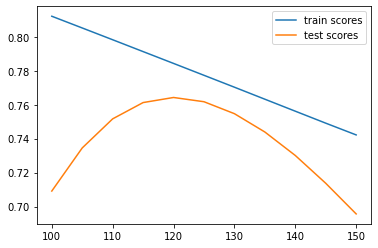

In [195]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_pol_TR_score = train_mx_test
lr_varclip_pol_TS_score = mx_test

### Random Forest Regressor + Poly + RUL clipped Variation

In [13]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

n_estimators = 64
max_depth = 9
min_samples_leaf = 10

for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)
    
    regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
    regr.fit(X_train_pol,y_train_clip)
    
    preds_train = regr.predict(X_train_pol)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = regr.predict(X_test_pol)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8832197718954946
 TEST SCORE WITH 100 upper clipped RUL:  0.7511053943384878
 TRAIN SCORE WITH 105 upper clipped RUL:  0.876240085473284
 TEST SCORE WITH 105 upper clipped RUL:  0.7822317896075376
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8698916887513779
 TEST SCORE WITH 110 upper clipped RUL:  0.7992969083837762
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8627795208637423
 TEST SCORE WITH 115 upper clipped RUL:  0.8079528432547107
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8566766403696677
 TEST SCORE WITH 120 upper clipped RUL:  0.8153106249042961
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8503178823177346
 TEST SCORE WITH 125 upper clipped RUL:  0.8063485223765179
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8429643093349737
 TEST SCORE WITH 130 upper clipped RUL:  0.7960930530744629
 TRAIN SCORE WITH 135 upper clipped RUL:  0.8358468910159825
 TEST SCORE WITH 135 upper clipped RUL:  0.790589365124235
 TRAIN SCORE WITH 140 upper clippe

Train Score from max Test Score:  0.8566766403696677 
 Max Test Score:  0.8153106249042961 
 Achieved with 120 upper clipped RUL


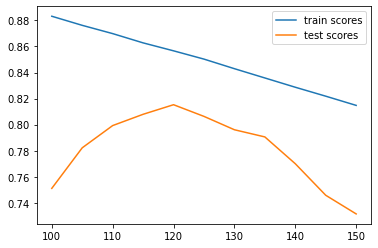

In [16]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
rf_varclip_pol_TR_score = train_mx_test
rf_varclip_pol_TS_score = mx_test

### SVR + Poly + RUL clipped Variation

In [38]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []


for clip in clips:

    y_train_clip = df_train_1["RUL"].clip(upper=clip)
    svr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
    svr.fit(X_train_pol, y_train_clip)

    preds_train = svr.predict(X_train_pol)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = svr.predict(X_test_pol)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_testL, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8302415866979951
 TEST SCORE WITH 100 upper clipped RUL:  0.7669354057583807
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8230103024583842
 TEST SCORE WITH 105 upper clipped RUL:  0.7875843372358154
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8151987473789022
 TEST SCORE WITH 110 upper clipped RUL:  0.7978147381148514
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8078793426575087
 TEST SCORE WITH 115 upper clipped RUL:  0.799546408531281
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8004115855333374
 TEST SCORE WITH 120 upper clipped RUL:  0.793793193027788
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7924427155066067
 TEST SCORE WITH 125 upper clipped RUL:  0.7831190092020519
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7846611779921707
 TEST SCORE WITH 130 upper clipped RUL:  0.7681661731888685
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7771692890796096
 TEST SCORE WITH 135 upper clipped RUL:  0.7506496287845837
 TRAIN SCORE WITH 140 upper clippe

Train Score from max Test Score:  0.8078793426575087 
 Max Test Score:  0.799546408531281 
 Achieved with 115 upper clipped RUL


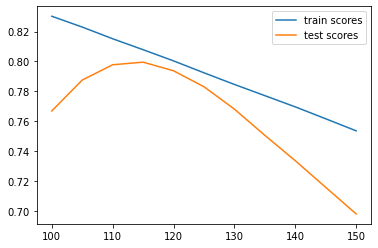

In [18]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores_svr)
mx_idx = test_scores_svr.index(mx_test)
train_mx_test = train_scores_svr[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))

We've beaten the best score!

Random Forest with lagged variables and RUL limited by 120 has reached a test score of 0.815, turning into the best model developed in this study.

Final Model definition for FD001 engines set RUL prediction:
- Random Forest Regressor
    - n_estimators = 64
    - max_depth = 9
    - min_samples_leaf = 10
- Polynomial variables transformation (2nd degree)
- RUL limited in train set at 120


            - Train Score:0.8566766403696677 
            - Test Score: 0.8153106249042961